<a href="https://colab.research.google.com/github/atropass/computer_vision/blob/main/object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [17]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [18]:
import os
from PIL import Image
import matplotlib.pyplot as plt

In [19]:
def display_images(folder_path, num_images=5):
    images = os.listdir(folder_path)[:num_images]
    plt.figure(figsize=(15, 10))
    for i, image_name in enumerate(images):
        img_path = os.path.join(folder_path, image_name)
        img = Image.open(img_path)
        plt.subplot(1, num_images, i + 1)
        plt.imshow(img)
        plt.title(image_name)
        plt.axis('off')
    plt.show()

In [20]:
calculator_images_path = '/content/drive/My Drive/EPAM OD/Calculator'
chocolate_images_path = '/content/drive/My Drive/EPAM OD/Chocolate'

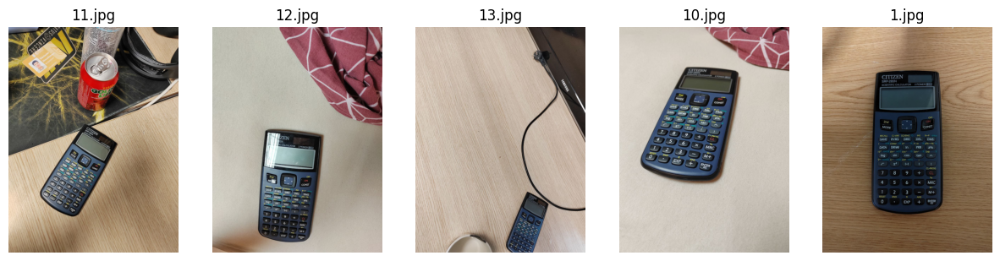

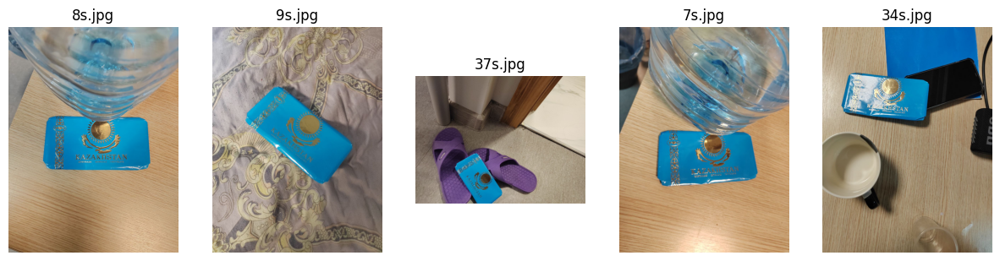

In [21]:
display_images(calculator_images_path)
display_images(chocolate_images_path)

In [22]:
import json
from pycocotools.coco import COCO
import matplotlib.patches as patches

In [23]:
annotations_path = '/content/drive/My Drive/EPAM OD/instances_default.json'
coco = COCO(annotations_path)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


In [24]:
def display_labeled_images(image_dir, coco, category_name, num_images=5):
    category_ids = coco.getCatIds(catNms=[category_name])
    image_ids = coco.getImgIds(catIds=category_ids)
    images = coco.loadImgs(image_ids[:num_images])

    for i, img_info in enumerate(images):
        image_path = os.path.join(image_dir, img_info['file_name'])
        image = Image.open(image_path)

        plt.figure(figsize=(8, 6))
        plt.imshow(image)
        plt.axis('off')

        ann_ids = coco.getAnnIds(imgIds=img_info['id'], catIds=category_ids, iscrowd=None)
        anns = coco.loadAnns(ann_ids)

        for ann in anns:
            bbox = ann['bbox']
            rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=2, edgecolor='r', facecolor='none')
            plt.gca().add_patch(rect)

        plt.show()

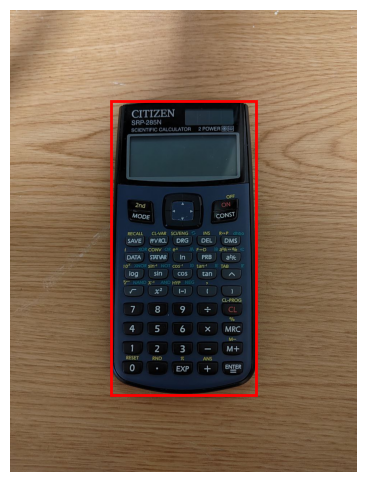

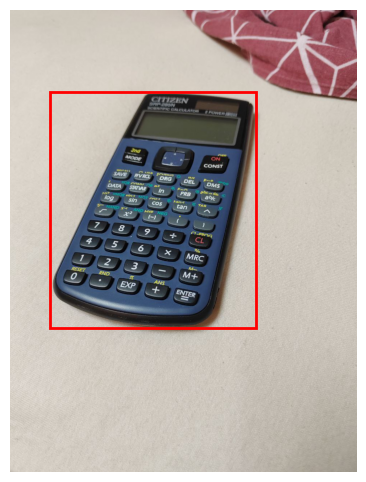

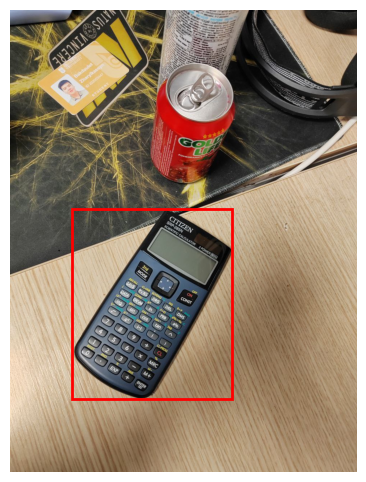

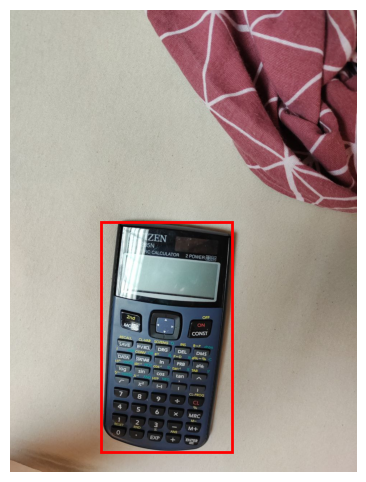

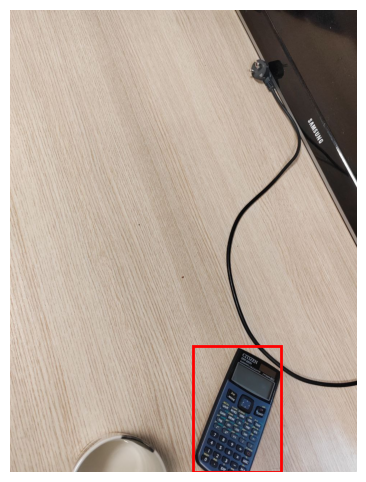

In [25]:
display_labeled_images(calculator_images_path, coco, 'calculator')

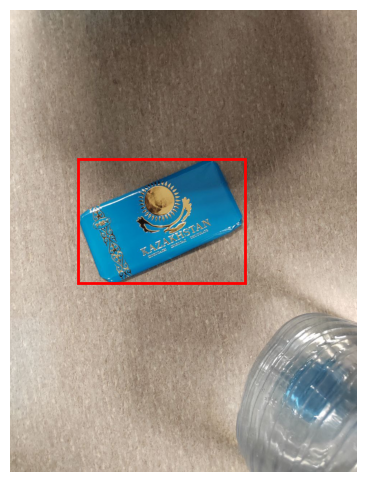

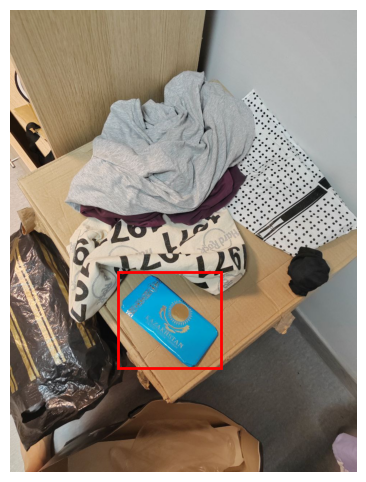

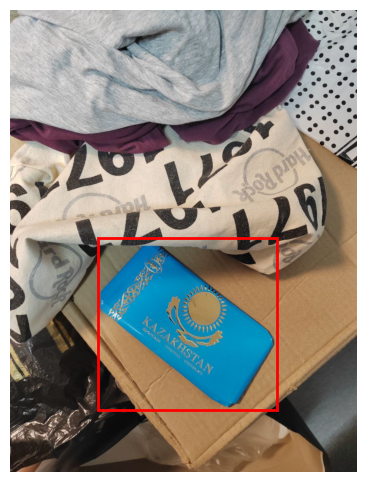

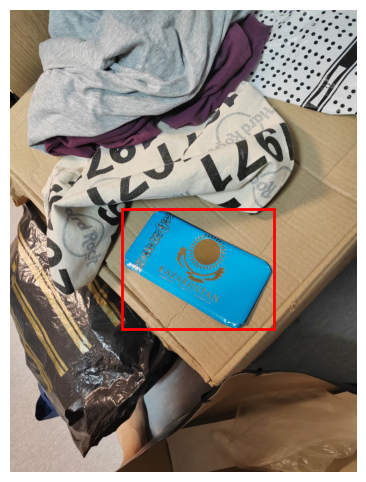

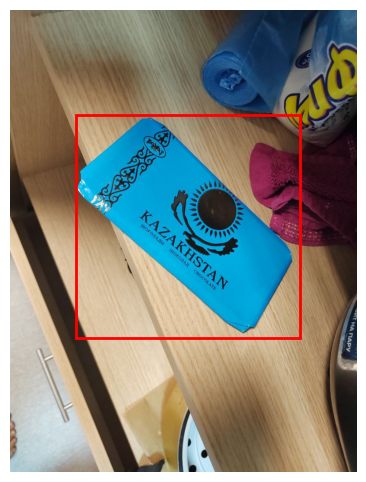

In [26]:
display_labeled_images(chocolate_images_path, coco, 'chocolate')

In [27]:
target_size = (512, 512)

In [28]:
with open('/content/drive/My Drive/EPAM OD/instances_default.json') as json_file:
    data = json.load(json_file)

In [29]:
updated_annotations = {'images': [], 'annotations': [], 'categories': data['categories']}

In [30]:
def update_image_annotations(folder_name):
    for img_info in data['images']:
        image_path = os.path.join('/content/drive/My Drive/EPAM OD', folder_name, img_info['file_name'])
        if os.path.exists(image_path):
            with Image.open(image_path) as img:
                original_size = img.size

                img = img.resize(target_size, Image.LANCZOS)
                img.save(image_path)
                img_info['width'], img_info['height'] = target_size
                updated_annotations['images'].append(img_info)
            for ann in data['annotations']:
                if ann['image_id'] == img_info['id']:
                    x_scale = target_size[0] / original_size[0]
                    y_scale = target_size[1] / original_size[1]
                    bbox = ann['bbox']
                    bbox[0] = round(bbox[0] * x_scale)
                    bbox[1] = round(bbox[1] * y_scale)
                    bbox[2] = round(bbox[2] * x_scale)
                    bbox[3] = round(bbox[3] * y_scale)
                    ann['bbox'] = bbox

                    updated_annotations['annotations'].append(ann)

In [31]:
update_image_annotations('Calculator')
update_image_annotations('Chocolate')

In [32]:
with open('/content/drive/My Drive/EPAM OD/updated_instances_default.json', 'w') as outfile:
    json.dump(updated_annotations, outfile)

In [33]:
annotations_path = '/content/drive/My Drive/EPAM OD/updated_instances_default.json'
coco = COCO(annotations_path)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [34]:
calculator_image_dir = '/content/drive/My Drive/EPAM OD/Calculator'
chocolate_image_dir = '/content/drive/My Drive/EPAM OD/Chocolate'

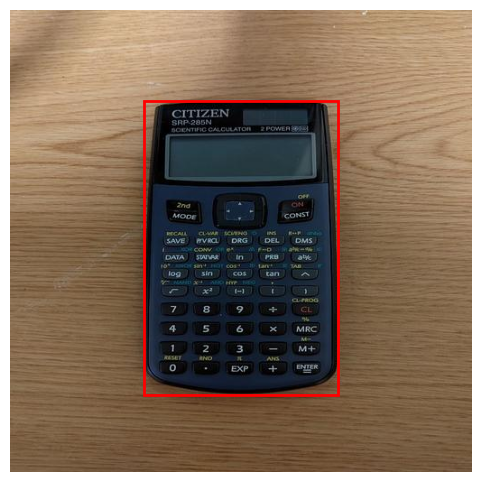

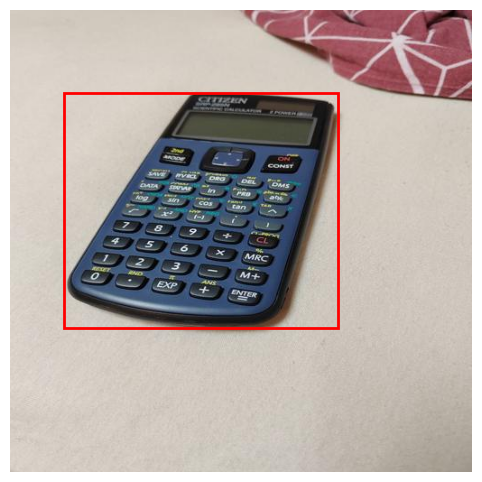

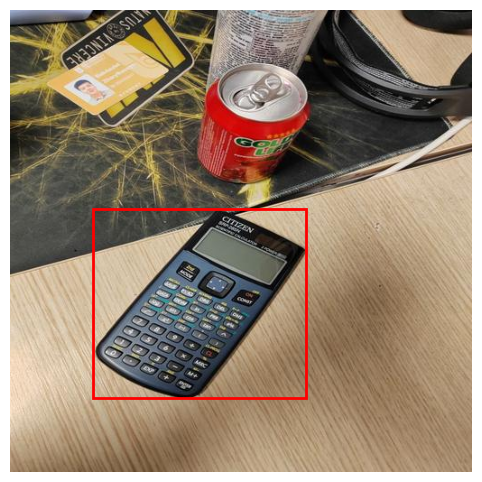

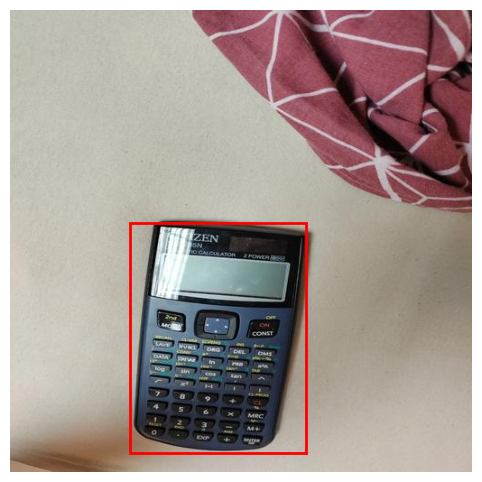

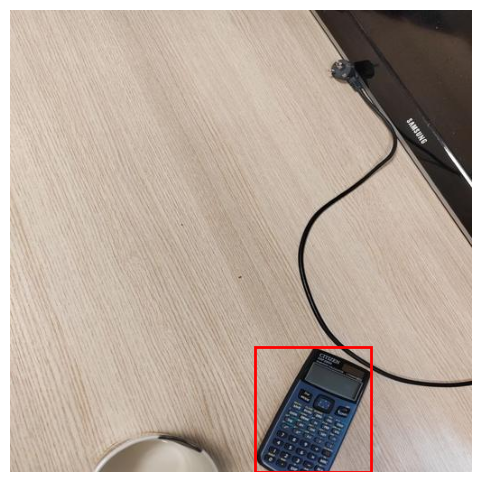

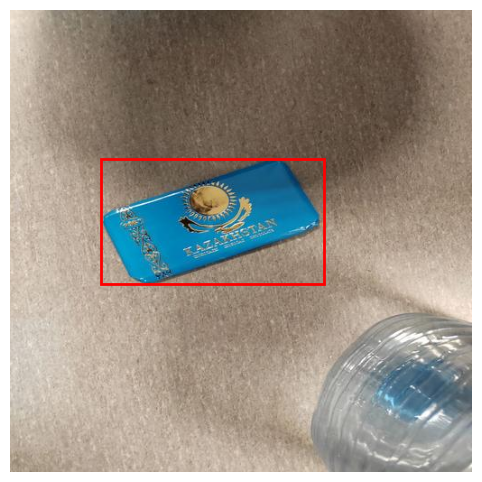

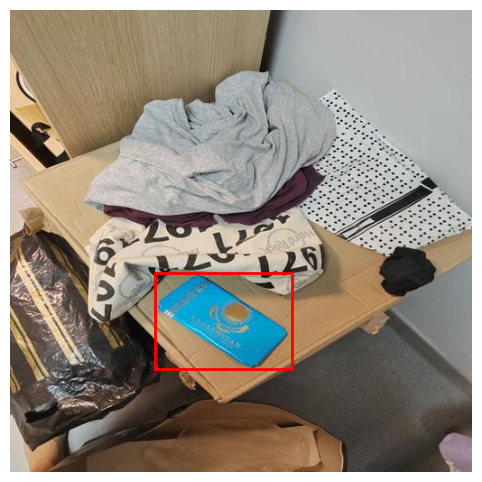

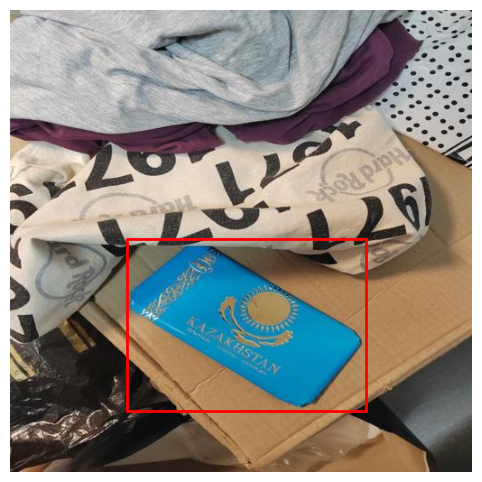

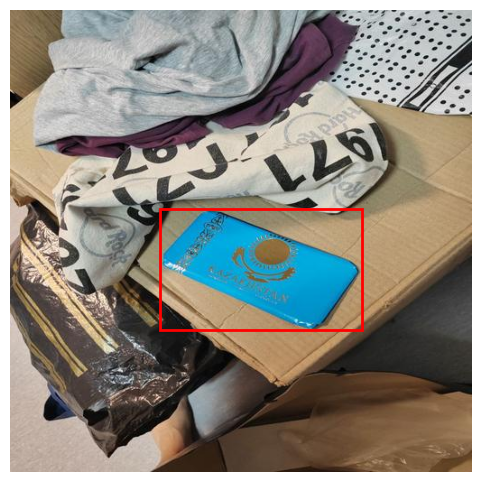

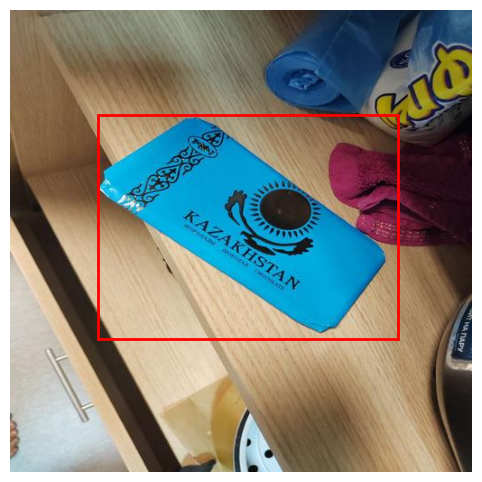

In [35]:

display_labeled_images(calculator_image_dir, coco, 'calculator')
display_labeled_images(chocolate_image_dir, coco, 'chocolate')


In [ ]:
def display_labeled_images(image_dir, category_name, coco, num_images=5):
    category_ids = coco.getCatIds(catNms=[category_name])
    image_ids = coco.getImgIds(catIds=category_ids)
    images = coco.loadImgs(image_ids[:num_images])

    for i, img_info in enumerate(images):
        image_path = os.path.join(image_dir, img_info['file_name'])
        image = Image.open(image_path)

        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        plt.axis('off')
        plt.title(f"{category_name}: {img_info['file_name']}")

        ann_ids = coco.getAnnIds(imgIds=img_info['id'], catIds=category_ids, iscrowd=None)
        anns = coco.loadAnns(ann_ids)

        for ann in anns:
            bbox = ann['bbox']
            label = coco.loadCats(ann['category_id'])[0]['name']
            rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=2, edgecolor='r', facecolor='none')
            plt.gca().add_patch(rect)
            plt.text(bbox[0], bbox[1], f'{label}', color='white', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))

        plt.show()

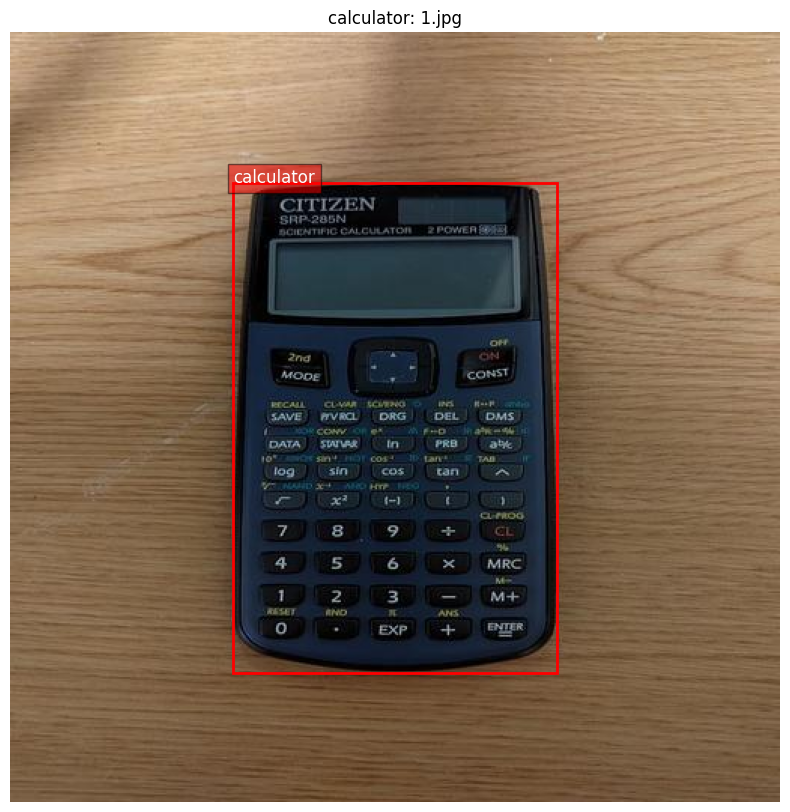

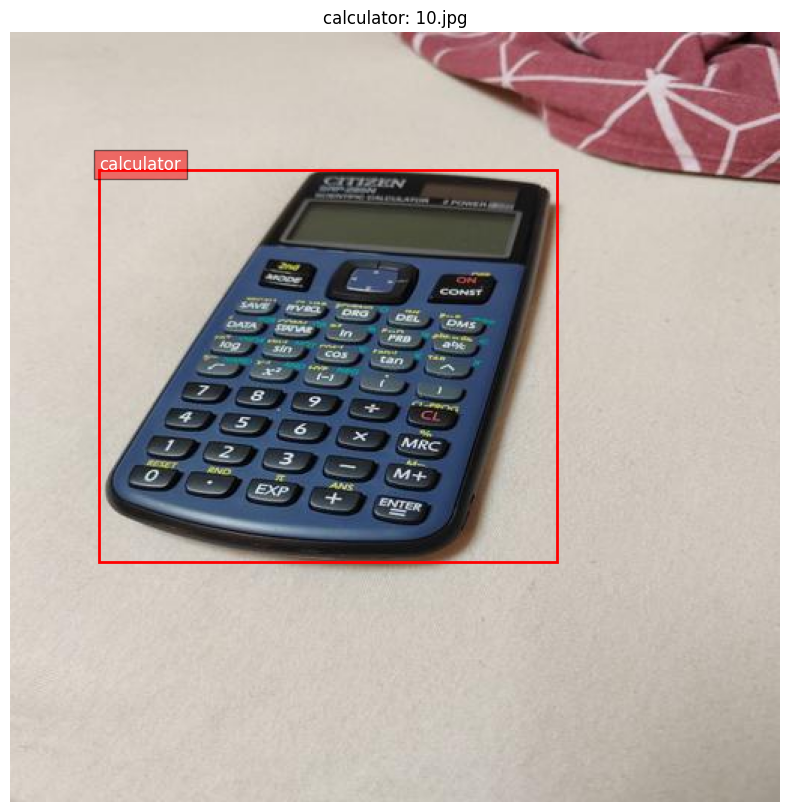

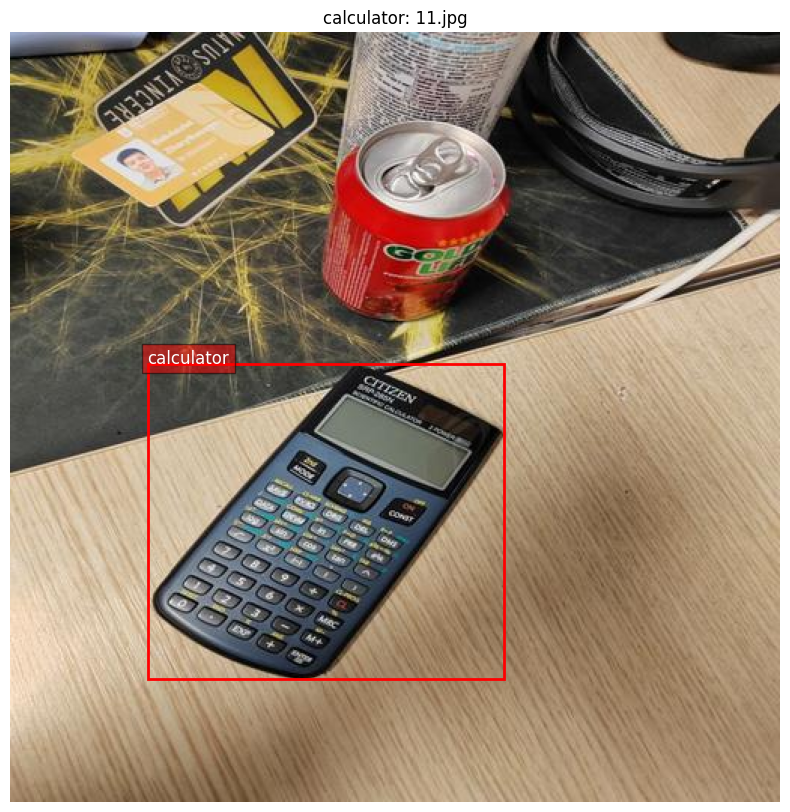

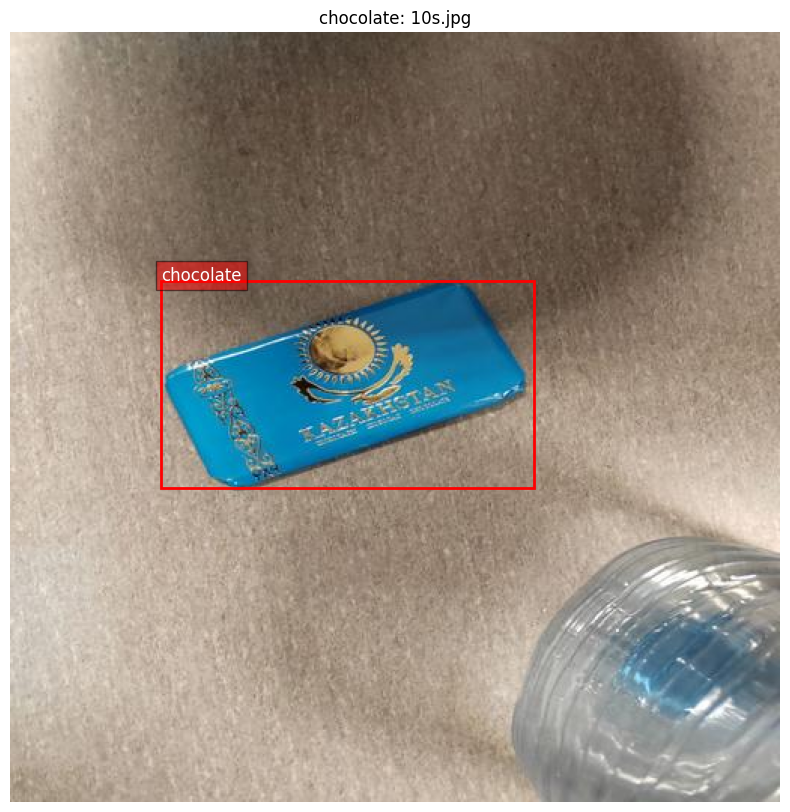

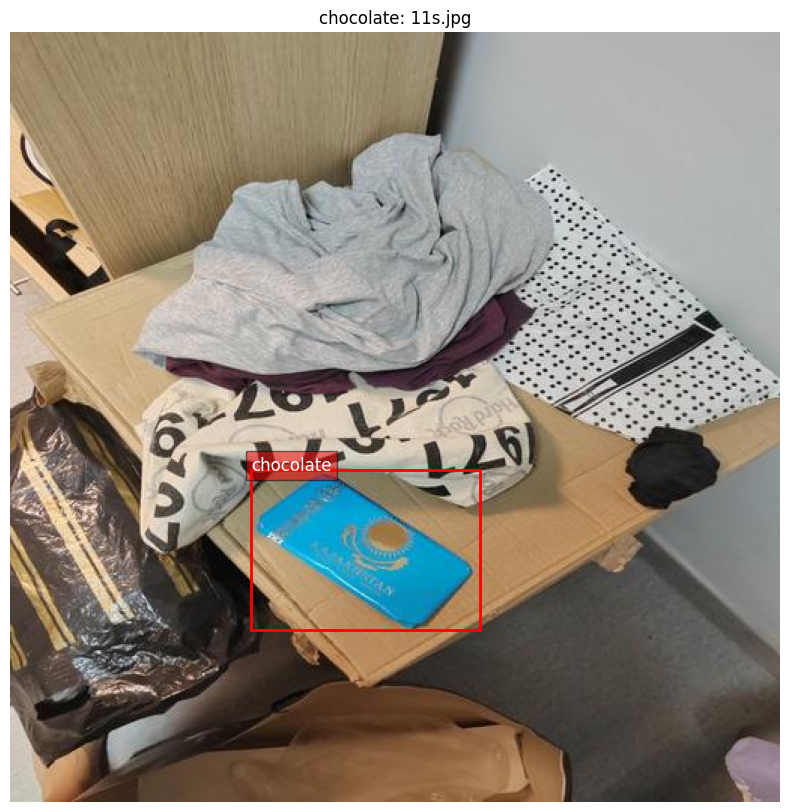

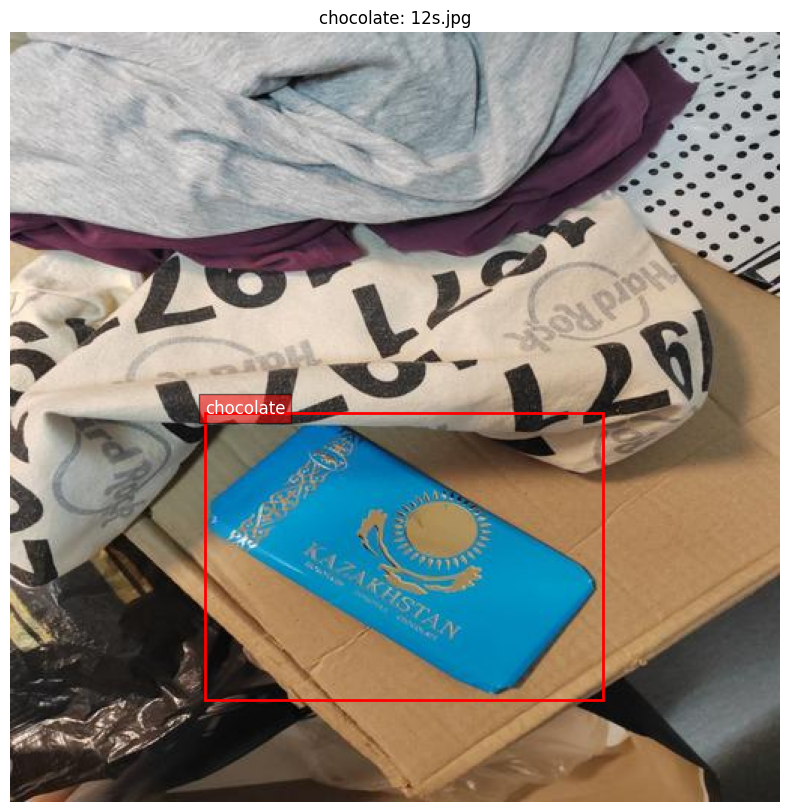

In [ ]:
display_labeled_images(calculator_image_dir, 'calculator', coco, num_images=3)
display_labeled_images(chocolate_image_dir, 'chocolate', coco, num_images=3)

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

In [ ]:
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from albumentations.pytorch import ToTensorV2
import albumentations as A

In [ ]:
import numpy as np

In [ ]:
def get_augmentation():
    return A.Compose([
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=0.2),
        A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=15, val_shift_limit=10, p=0.5),
    ], bbox_params=A.BboxParams(format='coco', label_fields=['category_ids']))

In [ ]:
def apply_augmentations(image_dir, coco, category_name, num_images=5):
    augmentation = get_augmentation()
    category_ids = coco.getCatIds(catNms=[category_name])
    image_ids = coco.getImgIds(catIds=category_ids)
    images = coco.loadImgs(image_ids[:num_images])
    augmented_images = []

    for img_info in images:
        image_path = os.path.join(image_dir, img_info['file_name'])
        image = Image.open(image_path)
        image = np.array(image)
        ann_ids = coco.getAnnIds(imgIds=img_info['id'], catIds=category_ids, iscrowd=None)
        anns = coco.loadAnns(ann_ids)
        bboxes = [ann['bbox'] for ann in anns]
        category_ids = [ann['category_id'] for ann in anns]

        transformed = augmentation(image=image, bboxes=bboxes, category_ids=category_ids)
        augmented_images.append((img_info, transformed['image'], transformed['bboxes'], transformed['category_ids']))

    return augmented_images

In [ ]:
def display_transformed_images(augmented_images):
    for img_info, image, bboxes, _ in augmented_images:
        plt.figure(figsize=(8, 6))
        plt.imshow(image)
        plt.axis('off')
        for bbox in bboxes:
            rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=2, edgecolor='r', facecolor='none')
            plt.gca().add_patch(rect)
        plt.show()

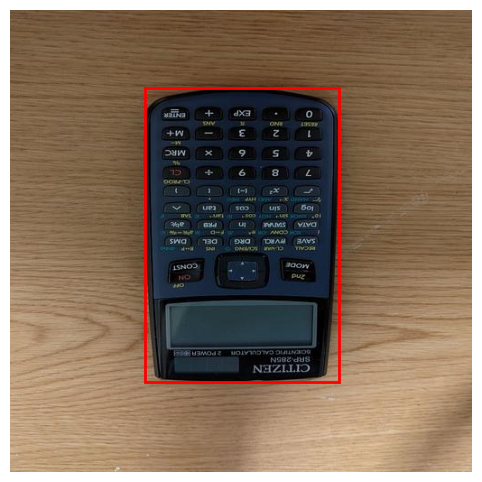

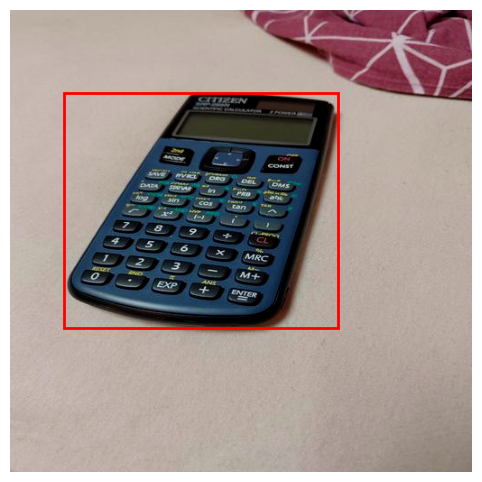

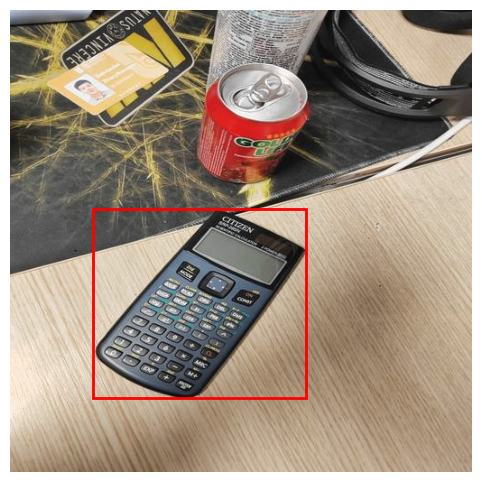

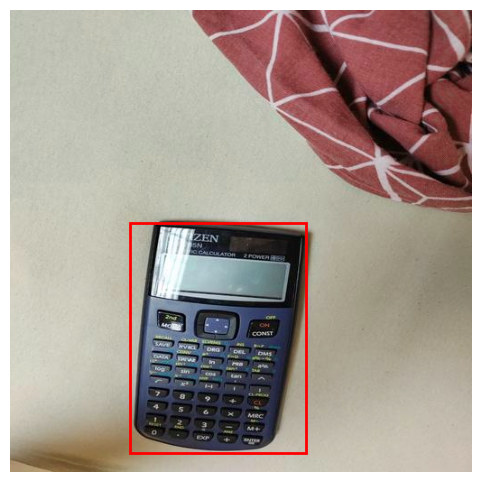

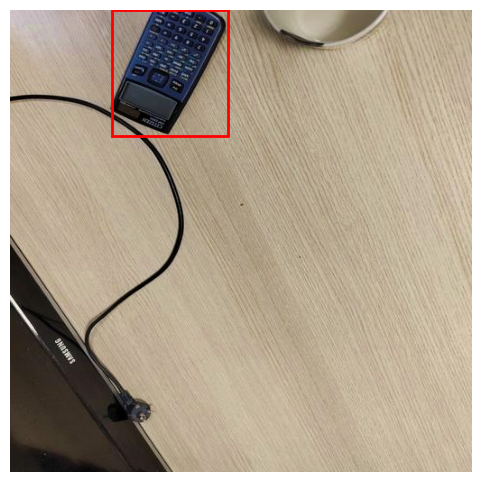

In [ ]:
augmented_calculators = apply_augmentations(calculator_image_dir, coco, 'calculator', num_images=5)
display_transformed_images(augmented_calculators)

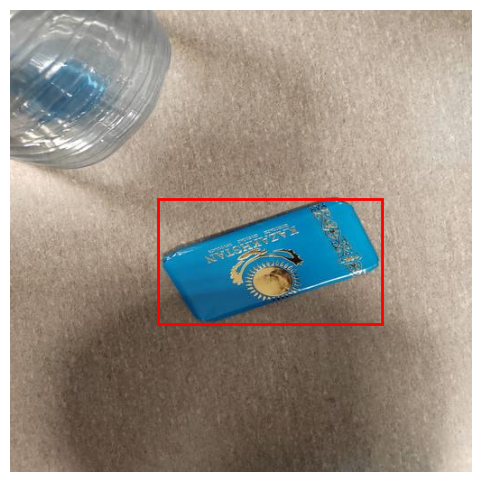

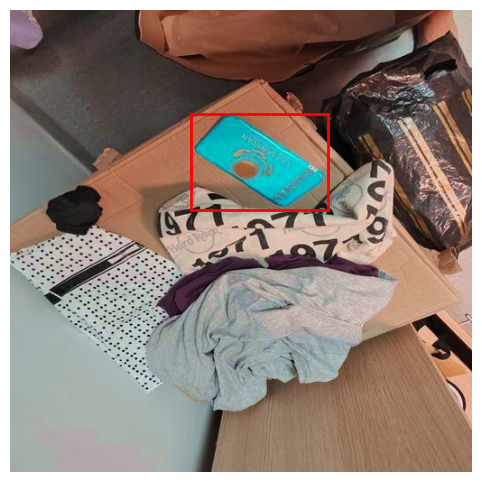

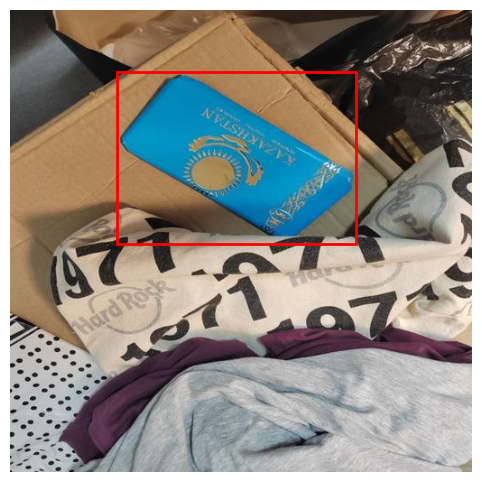

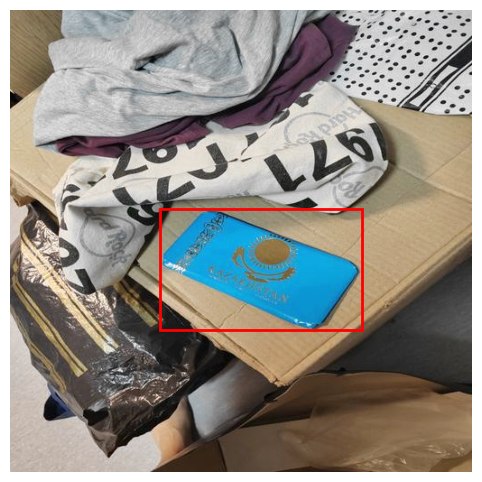

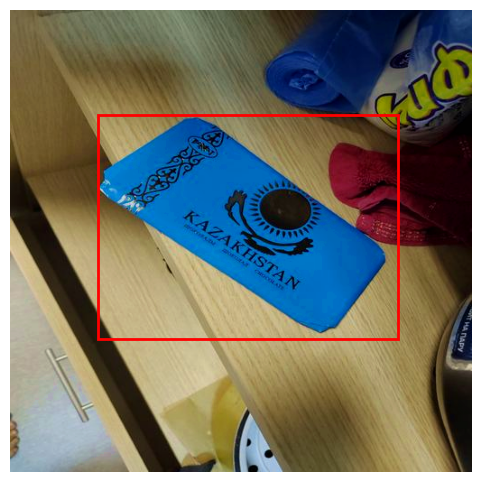

In [ ]:
augmented_chocolates = apply_augmentations(chocolate_image_dir, coco, 'chocolate', num_images=5)
display_transformed_images(augmented_chocolates)

In [ ]:
import torch
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.transforms import functional as F

In [ ]:
def split_dataset(image_dir, category, coco, num_test=10):
    category_ids = coco.getCatIds(catNms=[category])
    image_ids = coco.getImgIds(catIds=category_ids)
    np.random.shuffle(image_ids)
    train_ids = image_ids[num_test:]
    test_ids = image_ids[:num_test]
    return train_ids, test_ids

In [ ]:
import numpy as np

In [ ]:
train_ids_calculator, test_ids_calculator = split_dataset(calculator_image_dir, 'calculator', coco)
train_ids_chocolate, test_ids_chocolate = split_dataset(chocolate_image_dir, 'chocolate', coco)

In [ ]:
train_ids_chocolate

[29,
 25,
 15,
 41,
 39,
 5,
 71,
 31,
 11,
 69,
 43,
 53,
 17,
 47,
 63,
 35,
 13,
 57,
 3,
 19,
 44,
 65,
 33,
 79,
 61,
 87,
 55,
 21,
 59,
 85,
 22,
 73,
 49]

In [ ]:
test_ids_chocolate

[89, 83, 75, 27, 66, 9, 7, 37, 81, 51]

In [ ]:
def collate_fn(batch):
    return tuple(zip(*batch))

In [ ]:
class DetectionDataset(torch.utils.data.Dataset):
    def __init__(self, image_dir, ids, coco, is_chocolate=False, transforms=None):
        self.image_dir = image_dir
        self.ids = ids
        self.coco = coco
        self.is_chocolate = is_chocolate
        self.transforms = transforms

    def __getitem__(self, index):
        img_id = self.ids[index]
        img_info = self.coco.loadImgs(img_id)[0]
        if self.is_chocolate:
            path = os.path.join(self.image_dir, str(img_info['file_name'].split('.')[0]) + '.jpg')
        else:
            path = os.path.join(self.image_dir, img_info['file_name'])
        image = Image.open(path).convert("RGB")
        image = np.array(image)

        ann_ids = self.coco.getAnnIds(imgIds=img_id)
        anns = self.coco.loadAnns(ann_ids)
        bboxes = [ann['bbox'] for ann in anns]
        category_ids = [ann['category_id'] for ann in anns]

        if self.transforms:
            transformed = self.transforms(image=image, bboxes=bboxes, category_ids=category_ids)
            image = transformed['image']
            bboxes = transformed['bboxes']
            category_ids = transformed['category_ids']

        boxes = torch.as_tensor(bboxes, dtype=torch.float32).reshape(-1, 4)
        boxes[:, 2:] += boxes[:, :2]

        labels = torch.tensor(category_ids, dtype=torch.int64)
        target = {'boxes': boxes, 'labels': labels}

        return F.to_tensor(image), target


    def __len__(self):
        return len(self.ids)

In [ ]:
augmentation = get_augmentation()

In [ ]:
# def simple_transform(img, target):
#     img = F.resize(img, (512, 512))
#     target['boxes'] = target['boxes'] * torch.tensor([512 / img.width, 512 / img.height, 512 / img.width, 512 / img.height])
#     return img, target

In [ ]:
def simple_transform():
    return A.Compose([
        A.Resize(256, 256),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2()
    ], bbox_params=A.BboxParams(format='coco', label_fields=['category_ids']))

In [ ]:
train_dataset_calculator = DetectionDataset(calculator_image_dir, train_ids_calculator, coco, transforms=augmentation)
test_dataset_calculator = DetectionDataset(calculator_image_dir, test_ids_calculator, coco, transforms=simple_transform)


In [ ]:
train_ids_calculator

[58,
 42,
 38,
 8,
 62,
 26,
 40,
 32,
 84,
 60,
 54,
 88,
 14,
 24,
 10,
 48,
 2,
 16,
 20,
 82,
 18,
 50,
 52,
 78,
 4,
 46,
 12,
 67,
 64,
 56,
 23,
 1,
 45,
 86,
 72,
 76]

In [ ]:
len(train_dataset_calculator)

36

In [ ]:
train_dataset_chocolate = DetectionDataset(chocolate_image_dir, train_ids_chocolate, coco, is_chocolate=True, transforms=augmentation)
test_dataset_chocolate = DetectionDataset(chocolate_image_dir, test_ids_chocolate, coco, is_chocolate=True, transforms=simple_transform)

In [ ]:
from torch.utils.data import Dataset, DataLoader

In [ ]:
train_loader_calculator = DataLoader(train_dataset_calculator, batch_size=2, shuffle=True, collate_fn=collate_fn)
test_loader_calculator = DataLoader(test_dataset_calculator, batch_size=2, shuffle=False, collate_fn=collate_fn)

In [ ]:
train_loader_chocolate = DataLoader(train_dataset_chocolate, batch_size=2, shuffle=True, collate_fn=collate_fn)
test_loader_chocolate = DataLoader(test_dataset_chocolate, batch_size=2, shuffle=False, collate_fn=collate_fn)

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model.to(device)

In [ ]:
import torch
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
from sklearn.metrics import classification_report
from sklearn.metrics import precision_recall_fscore_support

In [ ]:
for param in model.parameters():
    param.requires_grad = False
for param in model.roi_heads.parameters():
    param.requires_grad = True

In [ ]:
optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.005)

In [ ]:
losses_per_epoch = []

In [ ]:
model.train()
num_epochs = 10
for epoch in range(num_epochs):
    total_loss = 0
    total_batches = 0

    for images, targets in train_loader_calculator:
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()
        total_batches += 1

    for images, targets in train_loader_chocolate:
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()
        total_batches += 1

    avg_loss = total_loss / total_batches
    losses_per_epoch.append(avg_loss)
    print(f"Epoch {epoch+1}, Loss: {avg_loss}")


Epoch 1, Loss: 13.413043036205428
Epoch 2, Loss: 0.31187004446983335
Epoch 3, Loss: 0.2928837469645909
Epoch 4, Loss: 0.2528470379965646
Epoch 5, Loss: 0.2274970803941999
Epoch 6, Loss: 0.21829898825713567
Epoch 7, Loss: 0.21392483328069958
Epoch 8, Loss: 0.20029159315994807
Epoch 9, Loss: 0.1771105862089566
Epoch 10, Loss: 0.18160401859453745


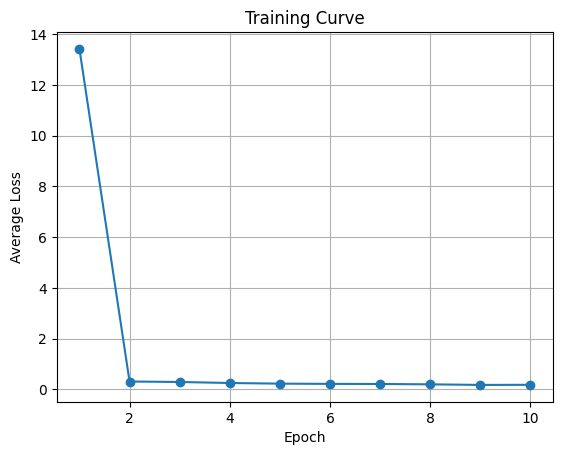

In [ ]:
plt.plot(range(1, 11), losses_per_epoch, marker='o')
plt.xlabel('Epoch')
plt.ylabel('Average Loss')
plt.title('Training Curve')
plt.grid(True)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torchvision.transforms.functional import to_tensor
from PIL import Image

In [ ]:
def predict_and_visualize(model, image_dir, image_ids, coco, device, num_images=10, return_scores=False):
    model.eval()
    image_scores = []

    images = coco.loadImgs(image_ids[:num_images])
    for img_info in images:
        image_path = os.path.join(image_dir, img_info['file_name'])
        image = Image.open(image_path).convert("RGB")
        image_tensor = to_tensor(image).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(image_tensor)
        output = [{k: v.to('cpu') for k, v in t.items()} for t in output]

        if return_scores:
            for score in output[0]['scores']:
                image_scores.append((img_info['file_name'], score.item()))

        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        ax = plt.gca()

        for idx, box in enumerate(output[0]['boxes']):
            score = output[0]['scores'][idx]
            label = output[0]['labels'][idx]
            if score > 0.83:
                x_min, y_min, x_max, y_max = box
                rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, linewidth=2, edgecolor='r', facecolor='none')
                ax.add_patch(rect)
                label_name = coco.loadCats(label.item())[0]['name'] if coco else f'Label {label.item()}'
                plt.text(x_min, y_min, f'{label_name}: {score:.2f}', color='white', bbox=dict(facecolor='red', alpha=0.5))
        plt.axis('off')
        plt.show()

    return image_scores


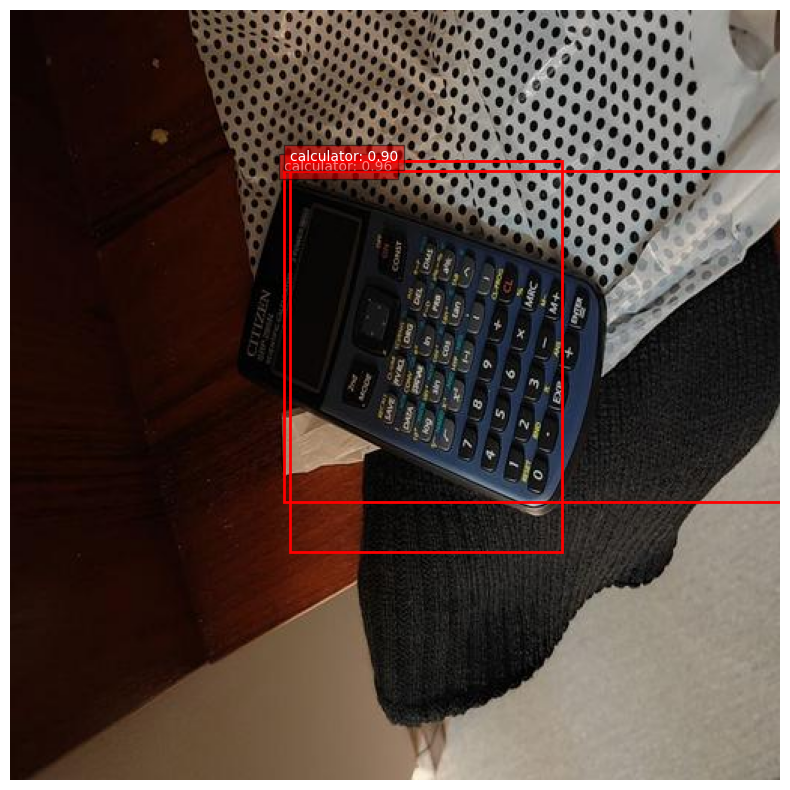

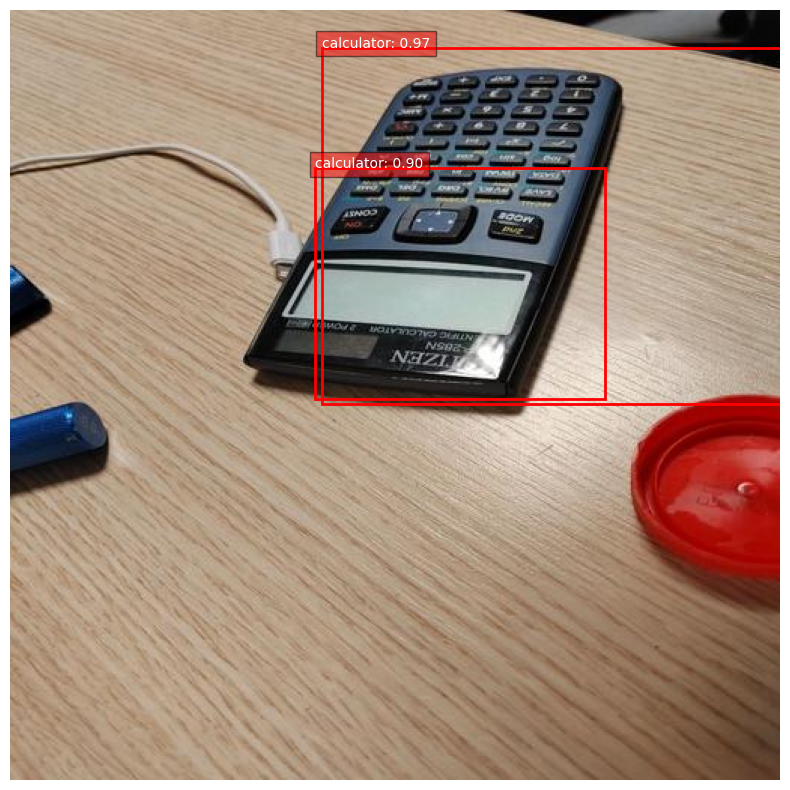

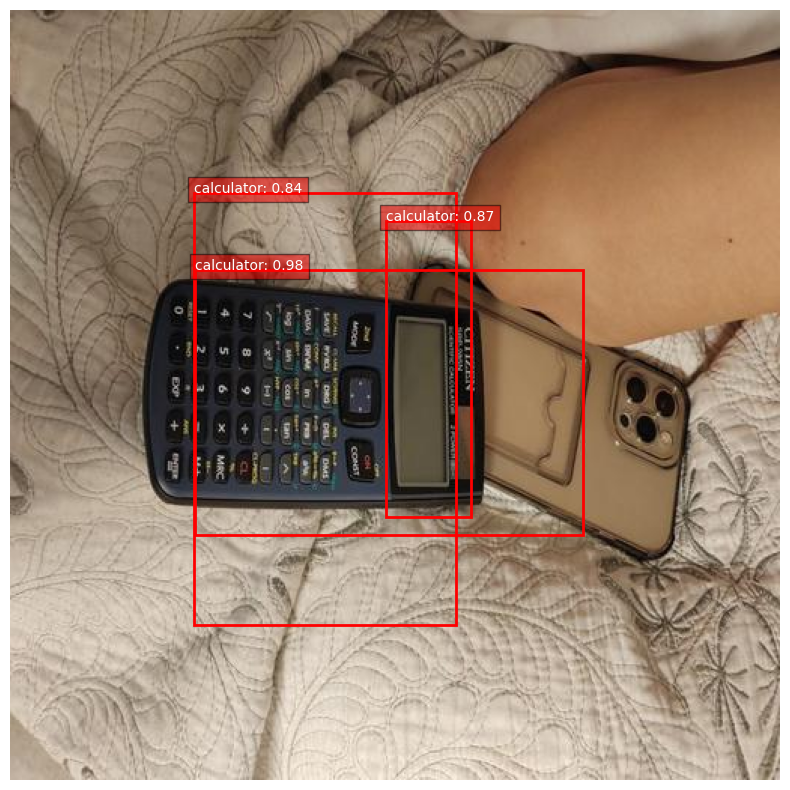

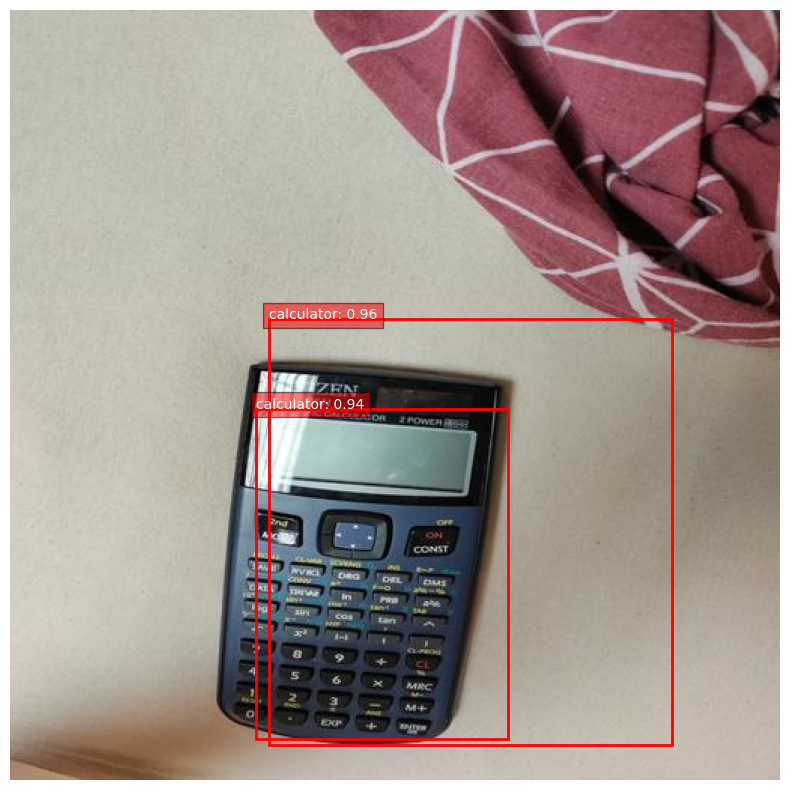

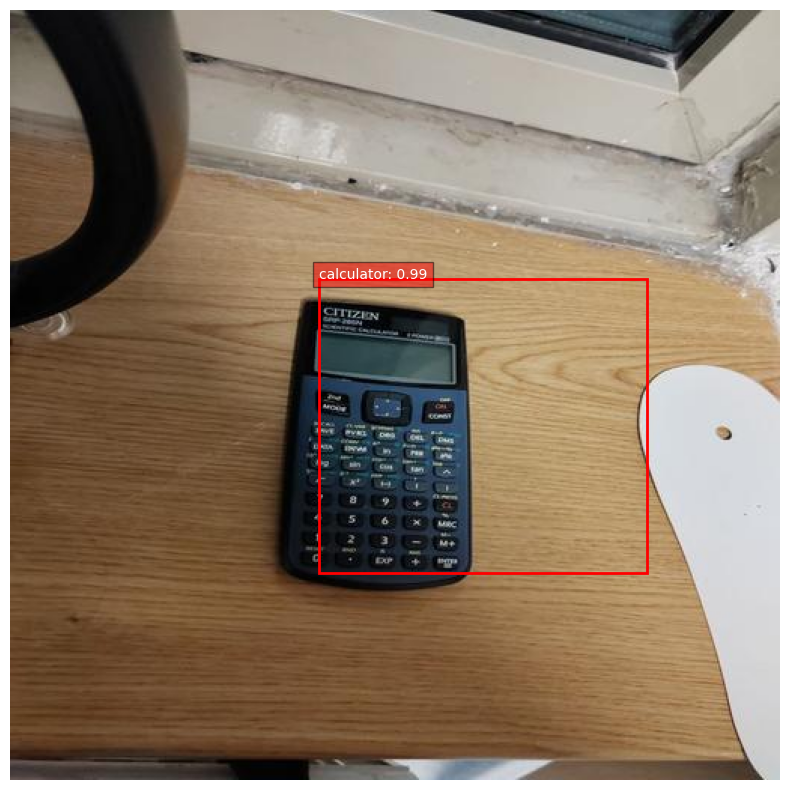

[]

In [ ]:
test_ids_calculator = [img['id'] for img in coco.loadImgs(ids=test_ids_calculator)]
predict_and_visualize(model, calculator_image_dir, test_ids_calculator, coco, device, num_images=5)

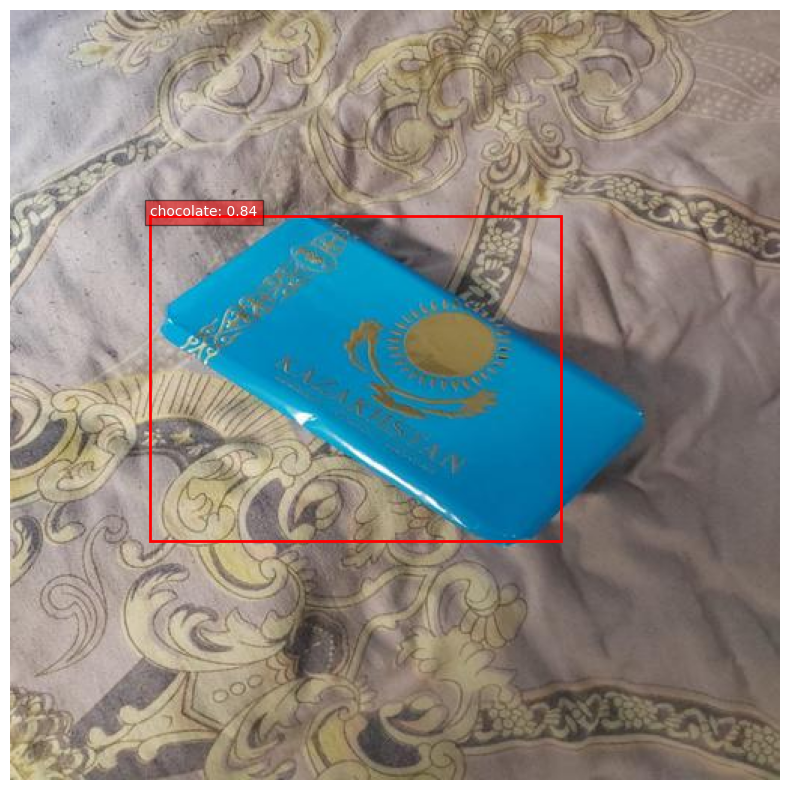

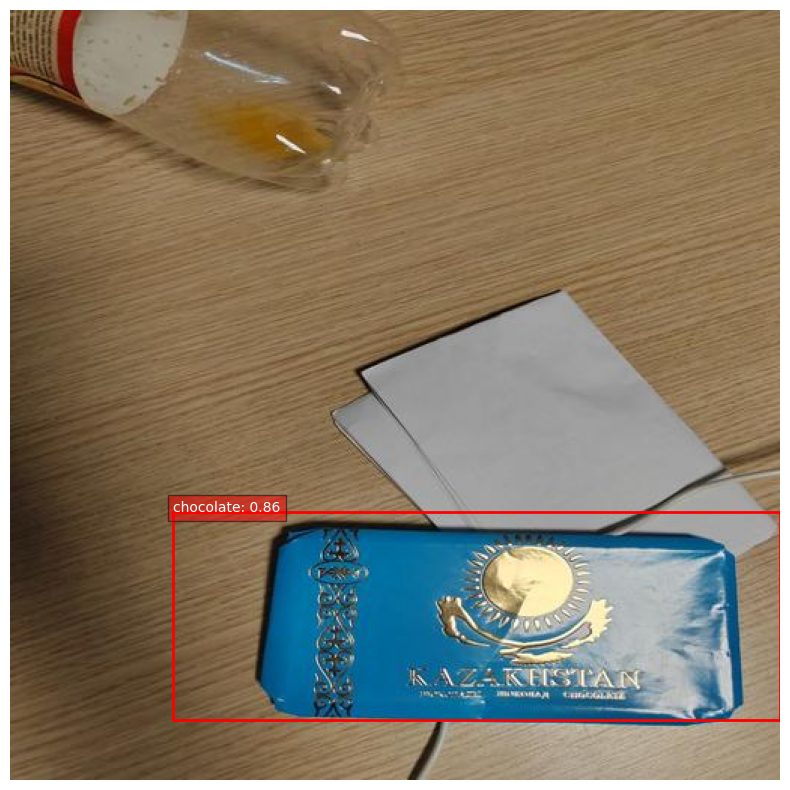

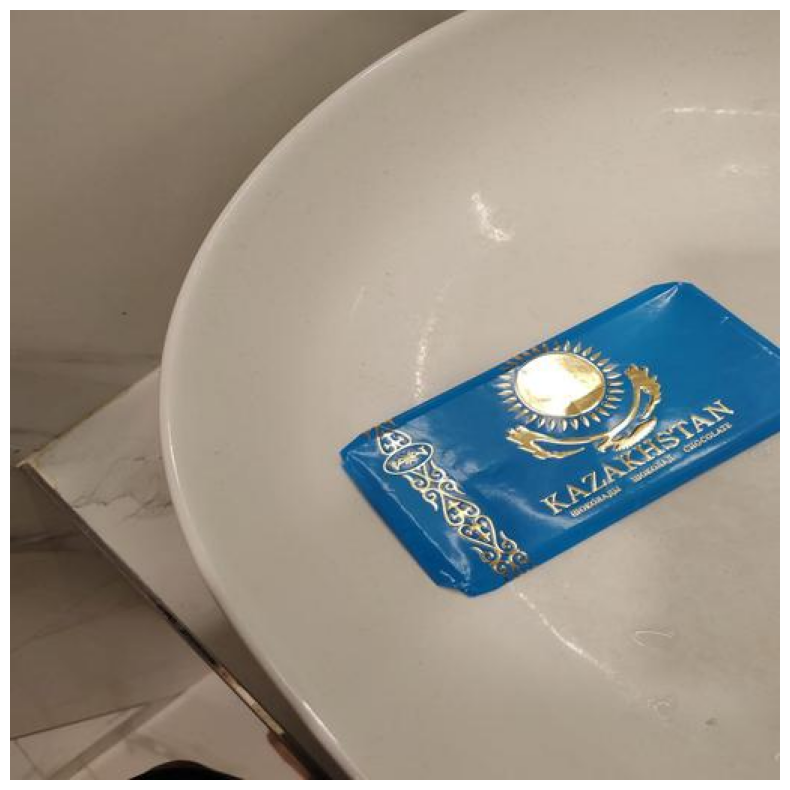

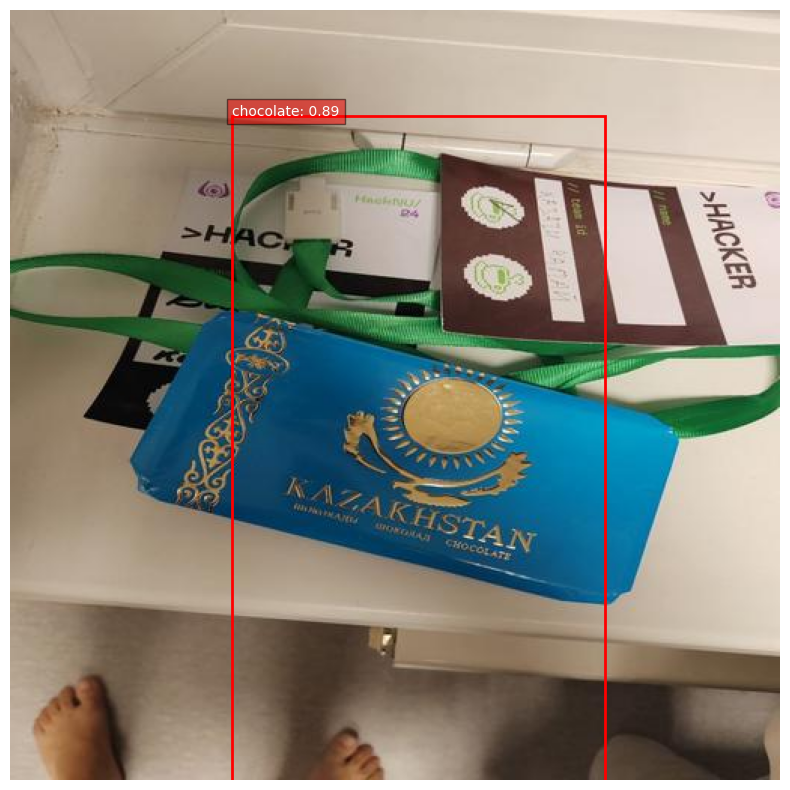

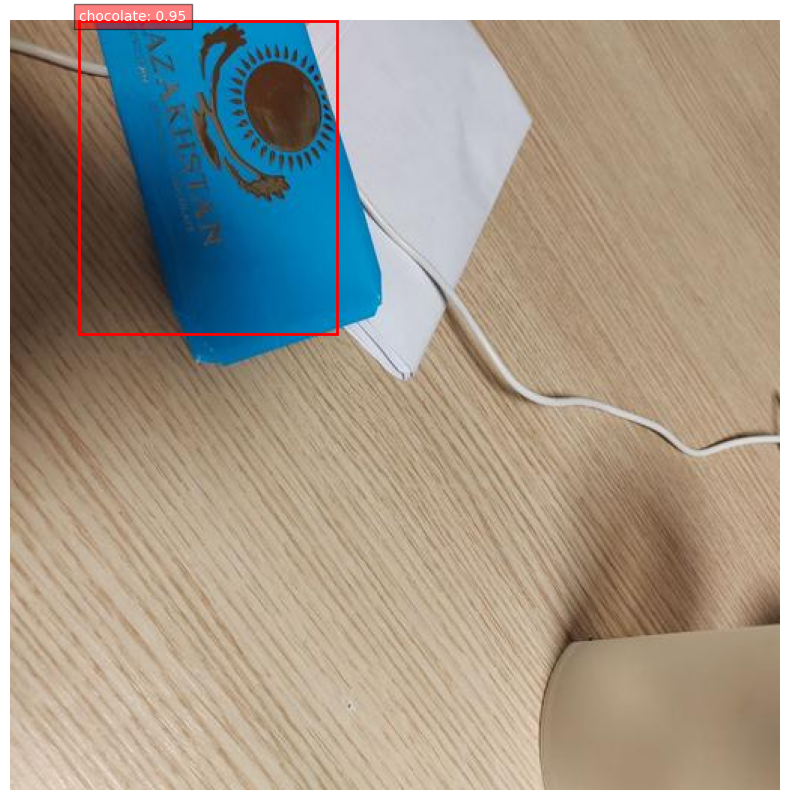

[]

In [ ]:
test_ids_chocolate = [img['id'] for img in coco.loadImgs(ids=test_ids_chocolate)]
predict_and_visualize(model, chocolate_image_dir, test_ids_chocolate, coco, device, num_images=5)

In [ ]:
test_ids_calculator

[34, 36, 28, 6, 80, 77, 68, 30, 74, 70]

In [ ]:
test_ids_chocolate

[89, 83, 75, 27, 66, 9, 7, 37, 81, 51]

In [ ]:
def visualize_best_and_worst_predictions(predictions, image_dir, coco, num_examples=5):
    sorted_predictions = sorted(predictions, key=lambda x: x['score'], reverse=True)

    best_predictions = sorted_predictions[:num_examples]
    worst_predictions = sorted_predictions[-num_examples:]

    def plot_image(prediction, ax):
        img_info = coco.loadImgs(prediction['image_id'])[0]
        image_path = os.path.join(image_dir, img_info['file_name'])
        image = Image.open(image_path).convert("RGB")
        ax.imshow(image)
        ax.axis('off')
        bbox = prediction['bbox']
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        label_name = coco.loadCats(prediction['category_id'])[0]['name']
        ax.set_title(f"{label_name}: {prediction['score']:.2f}")

    fig, axs = plt.subplots(2, num_examples, figsize=(15, 8))
    for i, prediction in enumerate(best_predictions):
        plot_image(prediction, axs[0, i])
    for i, prediction in enumerate(worst_predictions):
        plot_image(prediction, axs[1, i])

    plt.show()

In [ ]:
def generate_predictions(model, dataset, device):
    model.eval()
    results = []
    for img_id in dataset.ids:
        img_info = dataset.coco.loadImgs(img_id)[0]
        image_path = os.path.join(dataset.image_dir, img_info['file_name'])
        image = Image.open(image_path).convert('RGB')
        image_tensor = F.to_tensor(image).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(image_tensor)[0]

        for box, label, score in zip(output['boxes'], output['labels'], output['scores']):
            bbox = box.cpu().numpy().tolist()
            bbox = [bbox[0], bbox[1], bbox[2] - bbox[0], bbox[3] - bbox[1]]
            result = {
                'image_id': img_id,
                'category_id': label.item(),
                'bbox': bbox,
                'score': score.item()
            }
            results.append(result)
    return results

In [ ]:
predictions_calculator = generate_predictions(model, test_dataset_calculator, device)
predictions_chocolate = generate_predictions(model, test_dataset_chocolate, device)

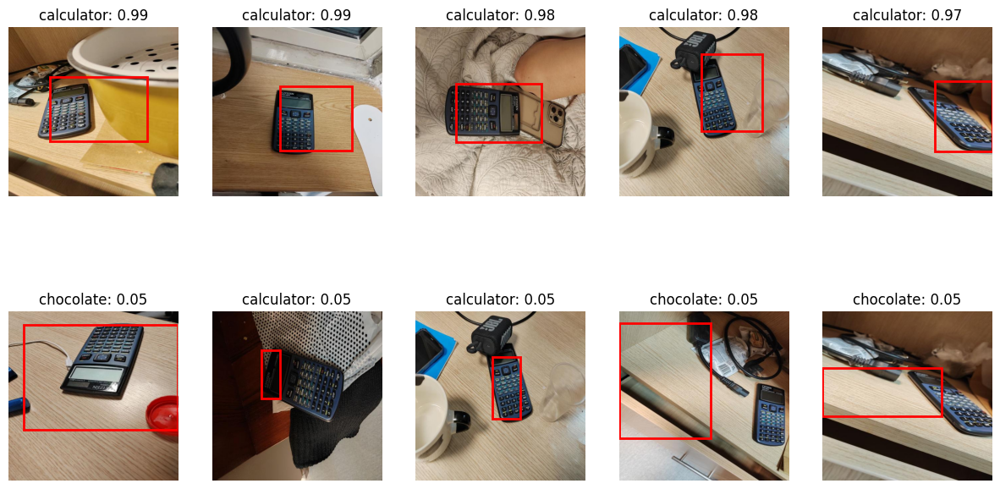

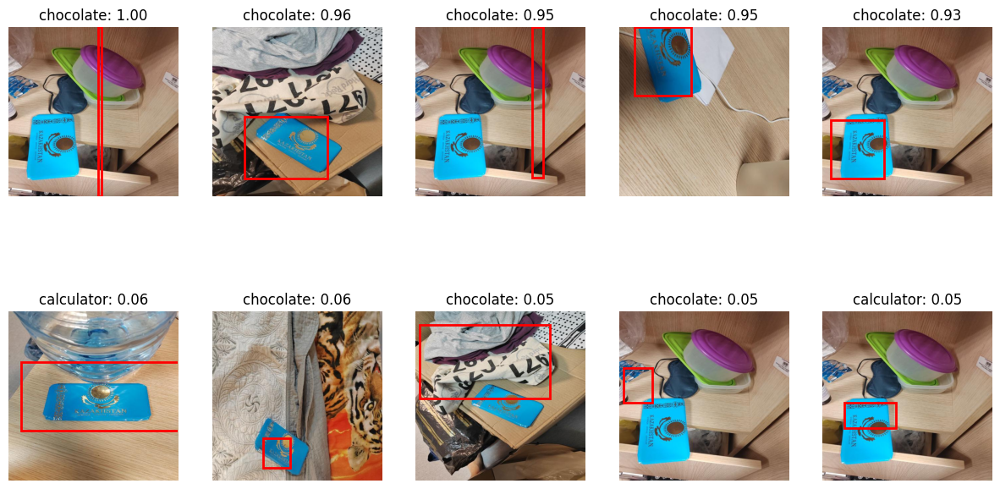

In [ ]:
visualize_best_and_worst_predictions(predictions_calculator, calculator_image_dir, coco)
visualize_best_and_worst_predictions(predictions_chocolate, chocolate_image_dir, coco)

# YOLO


In [49]:
!pip install ultralytics matplotlib seaborn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.5/756.5 kB 11.2 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [38]:
import os
import json
import shutil
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from sklearn.model_selection import train_test_split
from PIL import Image
import albumentations as A
from albumentations.pytorch import ToTensorV2

In [41]:
calculator_images_path = '/content/drive/My Drive/EPAM OD/Calculator'
chocolate_images_path = '/content/drive/My Drive/EPAM OD/Chocolate'
annotations_path = '/content/drive/My Drive/EPAM OD/updated_instances_default.json'

In [42]:
with open(annotations_path) as f:
    data = json.load(f)

In [43]:
dataset_path = '/content/yolo_dataset'
os.makedirs(dataset_path, exist_ok=True)
os.makedirs(f"{dataset_path}/images/train", exist_ok=True)
os.makedirs(f"{dataset_path}/images/val", exist_ok=True)
os.makedirs(f"{dataset_path}/labels/train", exist_ok=True)
os.makedirs(f"{dataset_path}/labels/val", exist_ok=True)

In [44]:
def convert_coco_to_yolo(data, images_path, split_ratio=0.2):
    images_info = data['images']
    annotations_info = data['annotations']
    categories_info = {cat['id']: cat['name'] for cat in data['categories']}

    img_to_anns = {}
    for ann in annotations_info:
        img_id = ann['image_id']
        if img_id not in img_to_anns:
            img_to_anns[img_id] = []
        img_to_anns[img_id].append(ann)

    train_imgs, val_imgs = train_test_split(images_info, test_size=split_ratio, random_state=42)

    def write_yolo_labels(image_info, anns, subset):
        img_path = os.path.join(images_path, image_info['file_name'])
        dest_img_path = f"{dataset_path}/images/{subset}/{image_info['file_name']}"
        label_file = f"{dataset_path}/labels/{subset}/{os.path.splitext(image_info['file_name'])[0]}.txt"

        if not os.path.exists(img_path):
            return

        shutil.copy(img_path, dest_img_path)
        with open(label_file, 'w') as lf:
            for ann in anns:
                category_id = ann['category_id'] - 1
                bbox = ann['bbox']
                x_center = (bbox[0] + bbox[2] / 2) / image_info['width']
                y_center = (bbox[1] + bbox[3] / 2) / image_info['height']
                width = bbox[2] / image_info['width']
                height = bbox[3] / image_info['height']
                lf.write(f"{category_id} {x_center} {y_center} {width} {height}\n")

    for img in train_imgs:
        anns = img_to_anns.get(img['id'], [])
        write_yolo_labels(img, anns, 'train')

    for img in val_imgs:
        anns = img_to_anns.get(img['id'], [])
        write_yolo_labels(img, anns, 'val')


In [45]:
convert_coco_to_yolo(data, calculator_images_path)
convert_coco_to_yolo(data, chocolate_images_path)

In [46]:
data_yaml = f"""
train: {dataset_path}/images/train
val: {dataset_path}/images/val

nc: {len(data['categories'])}
names: {[category['name'] for category in data['categories']]}
"""

In [47]:
with open(f"{dataset_path}/data.yaml", 'w') as f:
    f.write(data_yaml)

In [50]:
from ultralytics import YOLO

In [51]:
model = YOLO('yolov8n.pt')

100%|██████████| 6.23M/6.23M [00:00<00:00, 102MB/s]


In [52]:
results = model.train(
    data=f"{dataset_path}/data.yaml",
    epochs=10,
    imgsz=512,
    batch=8
)

Ultralytics YOLOv8.2.11 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/yolo_dataset/data.yaml, epochs=10, time=None, patience=100, batch=8, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, s

100%|██████████| 755k/755k [00:00<00:00, 22.5MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/yolo_dataset/labels/train... 71 images, 0 backgrounds, 0 corrupt: 100%|██████████| 71/71 [00:00<00:00, 371.75it/s]

train: New cache created: /content/yolo_dataset/labels/train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/yolo_dataset/labels/val... 18 images, 0 backgrounds, 0 corrupt: 100%|██████████| 18/18 [00:00<00:00, 556.84it/s]

val: New cache created: /content/yolo_dataset/labels/val.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10     0.847G     0.5319      3.211      1.002          7        512: 100%|██████████| 9/9 [00:05<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]

                   all         18         18    0.00373          1      0.694      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10     0.805G     0.5695      2.763     0.9883          7        512: 100%|██████████| 9/9 [00:01<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 10.75it/s]


                   all         18         18     0.0033          1      0.761      0.625

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10     0.799G     0.5571      1.856      0.951          7        512: 100%|██████████| 9/9 [00:01<00:00,  8.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.48it/s]

                   all         18         18      0.763      0.842      0.813      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10     0.803G     0.5547      1.666      0.937          7        512: 100%|██████████| 9/9 [00:01<00:00,  8.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 11.41it/s]


                   all         18         18      0.822      0.929      0.943       0.82

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10     0.803G     0.5152      1.569     0.9229          7        512: 100%|██████████| 9/9 [00:00<00:00,  9.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.45it/s]

                   all         18         18          1      0.557      0.958      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10     0.803G     0.5289      1.453      0.913          7        512: 100%|██████████| 9/9 [00:01<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.43it/s]

                   all         18         18      0.993       0.89      0.966      0.872



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10     0.803G      0.522      1.407     0.8938          7        512: 100%|██████████| 9/9 [00:01<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.32it/s]

                   all         18         18          1      0.804      0.995        0.9



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10     0.803G     0.4551      1.318     0.8754          7        512: 100%|██████████| 9/9 [00:02<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 10.77it/s]

                   all         18         18      0.991      0.875      0.995      0.929



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10     0.799G     0.4767      1.339     0.9083          7        512: 100%|██████████| 9/9 [00:01<00:00,  8.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 12.08it/s]


                   all         18         18      0.979      0.966      0.995      0.934

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10     0.805G     0.4615      1.238     0.9086          7        512: 100%|██████████| 9/9 [00:01<00:00,  8.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 11.84it/s]


                   all         18         18      0.979      0.982      0.995      0.935

10 epochs completed in 0.010 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.11 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  9.59it/s]


                   all         18         18      0.979      0.982      0.995      0.935
            calculator         18         11      0.957          1      0.995      0.904
             chocolate         18          7          1      0.965      0.995      0.967
Speed: 0.1ms preprocess, 3.2ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to runs/detect/train


In [53]:
metrics = model.val()

Ultralytics YOLOv8.2.11 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/yolo_dataset/labels/val.cache... 18 images, 0 backgrounds, 0 corrupt: 100%|██████████| 18/18 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]


                   all         18         18      0.979      0.982      0.995      0.935
            calculator         18         11      0.957          1      0.995      0.904
             chocolate         18          7          1      0.964      0.995      0.967
Speed: 2.1ms preprocess, 48.8ms inference, 0.0ms loss, 4.3ms postprocess per image
Results saved to runs/detect/train2


In [54]:
import matplotlib.pyplot as plt
from PIL import Image

In [91]:
def visualize_predictions(image_path):
    image = Image.open(image_path)
    results = model.predict(image, imgsz=512, conf=0.05)

    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    for box, conf, cls in zip(results[0].boxes.xyxy, results[0].boxes.conf, results[0].boxes.cls):
        label = results[0].names[int(cls)]
        x1, y1, x2, y2 = map(int, box)
        plt.gca().add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='r', facecolor='none'))
        plt.text(x1, y1, f"{label} {conf:.2f}", bbox=dict(facecolor='red', alpha=0.5), color='white')
    plt.axis('off')
    plt.show()


0: 512x512 1 calculator, 37.0ms
Speed: 1.6ms preprocess, 37.0ms inference, 4.0ms postprocess per image at shape (1, 3, 512, 512)


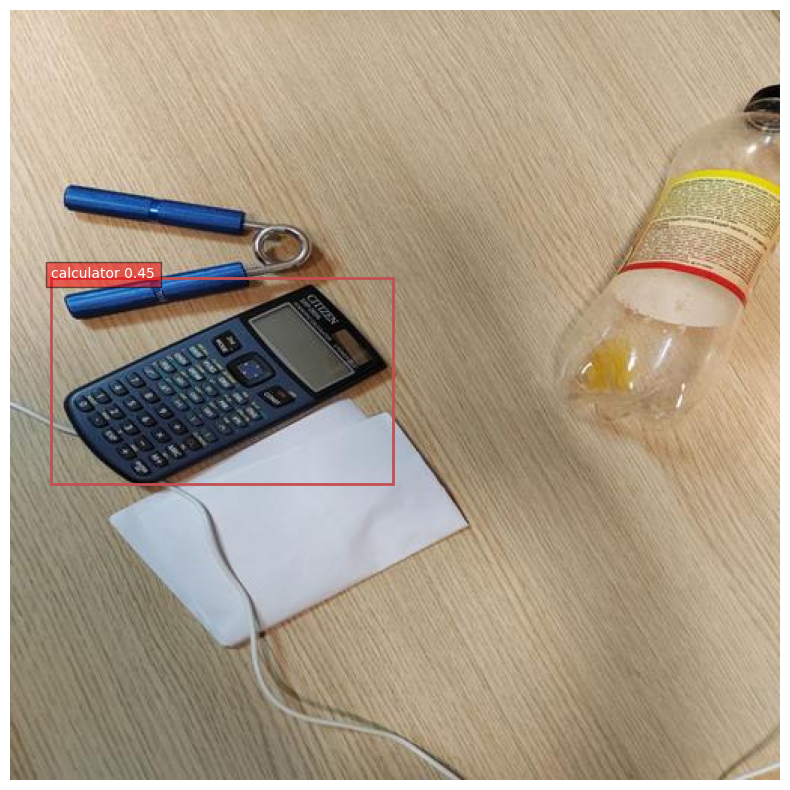


0: 512x512 1 calculator, 12.9ms
Speed: 1.4ms preprocess, 12.9ms inference, 2.4ms postprocess per image at shape (1, 3, 512, 512)


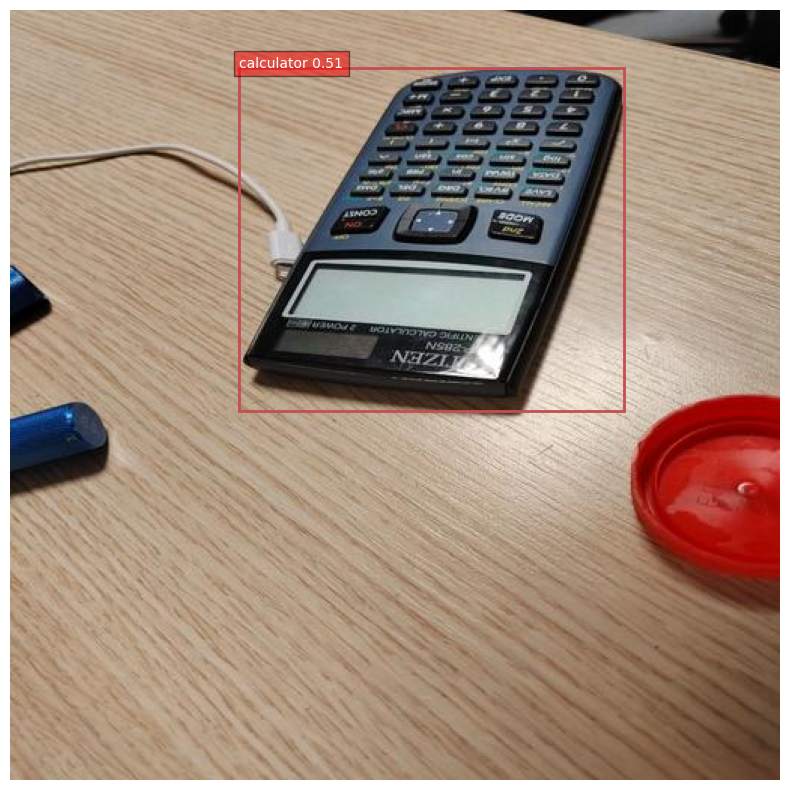


0: 512x512 1 chocolate, 17.8ms
Speed: 1.5ms preprocess, 17.8ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


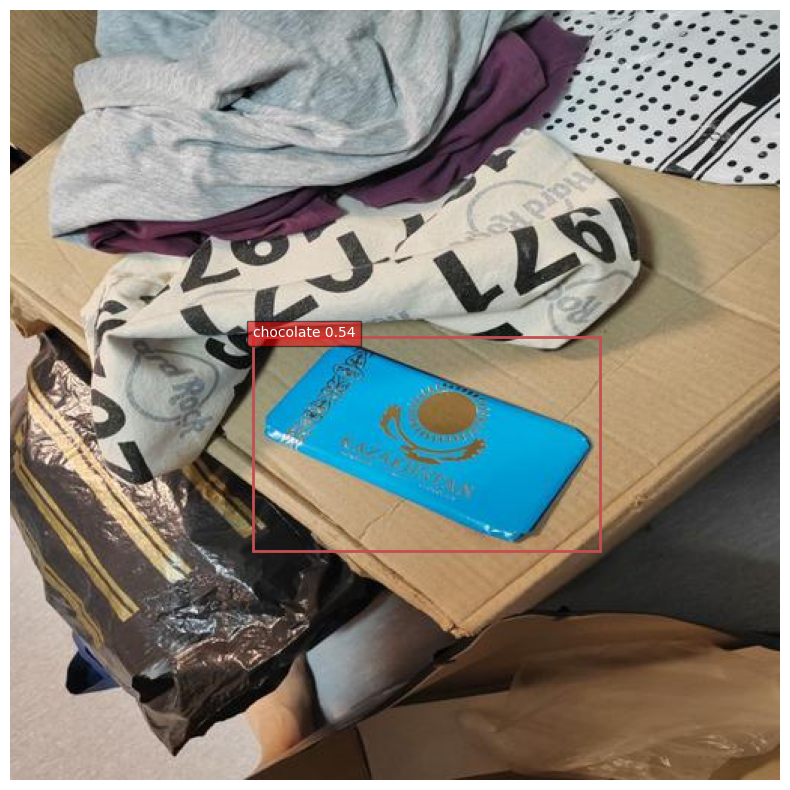


0: 512x512 1 chocolate, 12.3ms
Speed: 1.5ms preprocess, 12.3ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)


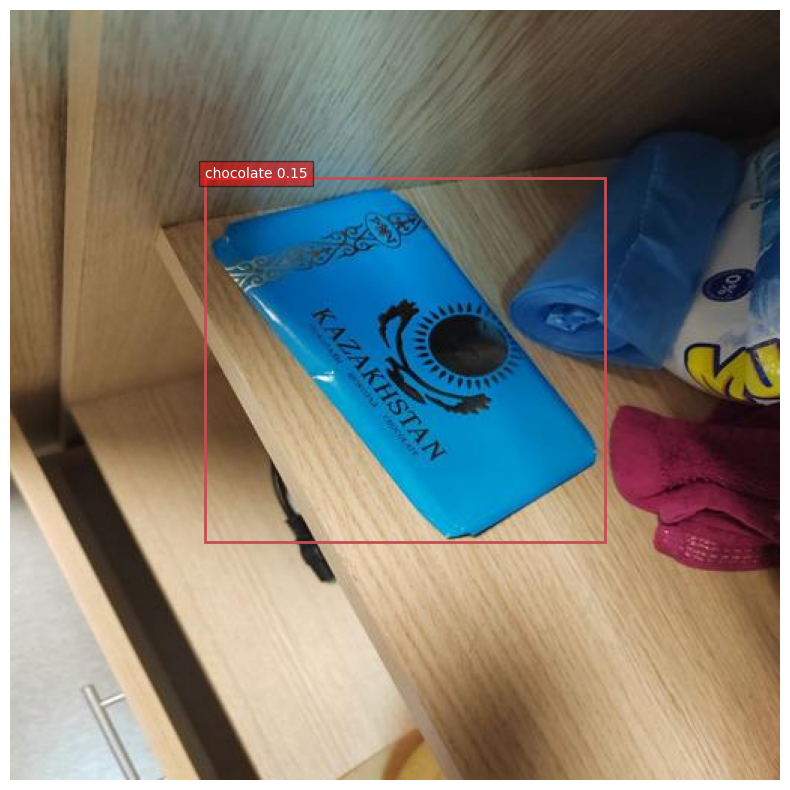


0: 512x512 1 calculator, 12.8ms
Speed: 1.4ms preprocess, 12.8ms inference, 2.2ms postprocess per image at shape (1, 3, 512, 512)


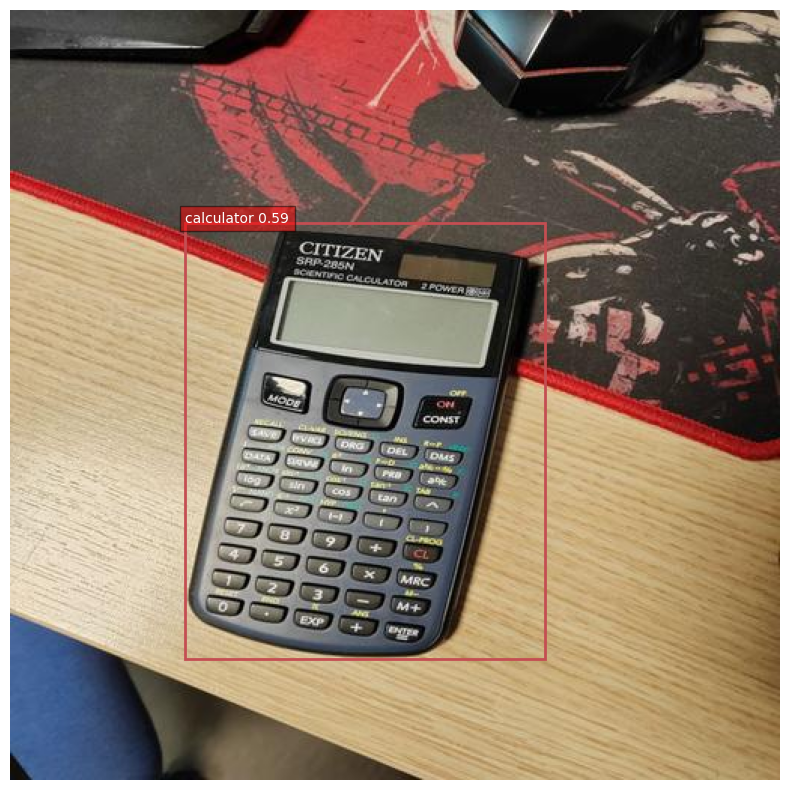


0: 512x512 1 chocolate, 18.9ms
Speed: 1.4ms preprocess, 18.9ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


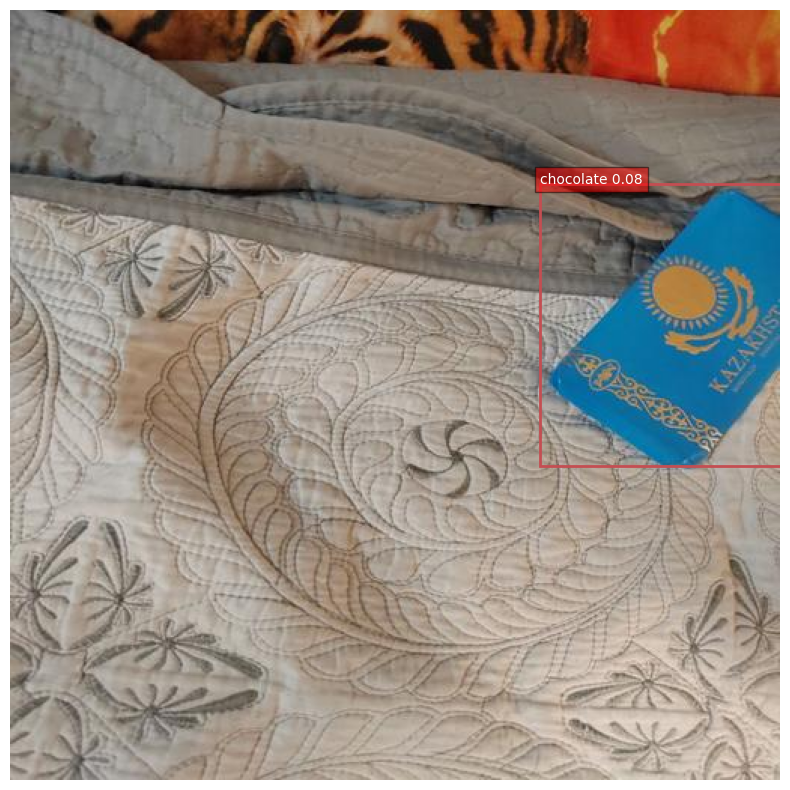


0: 512x512 1 calculator, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


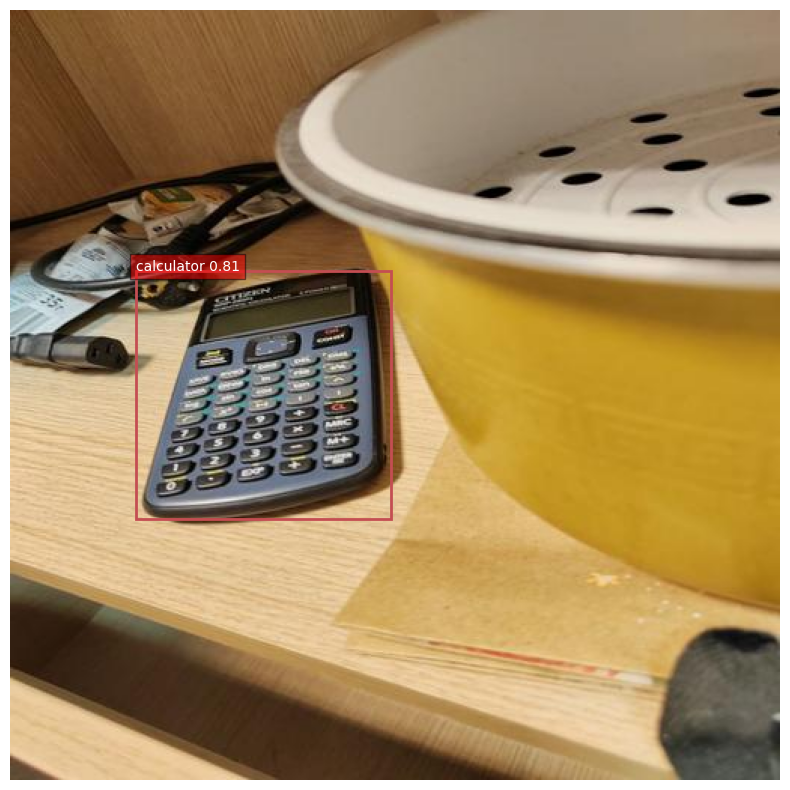


0: 512x512 1 calculator, 13.8ms
Speed: 1.5ms preprocess, 13.8ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


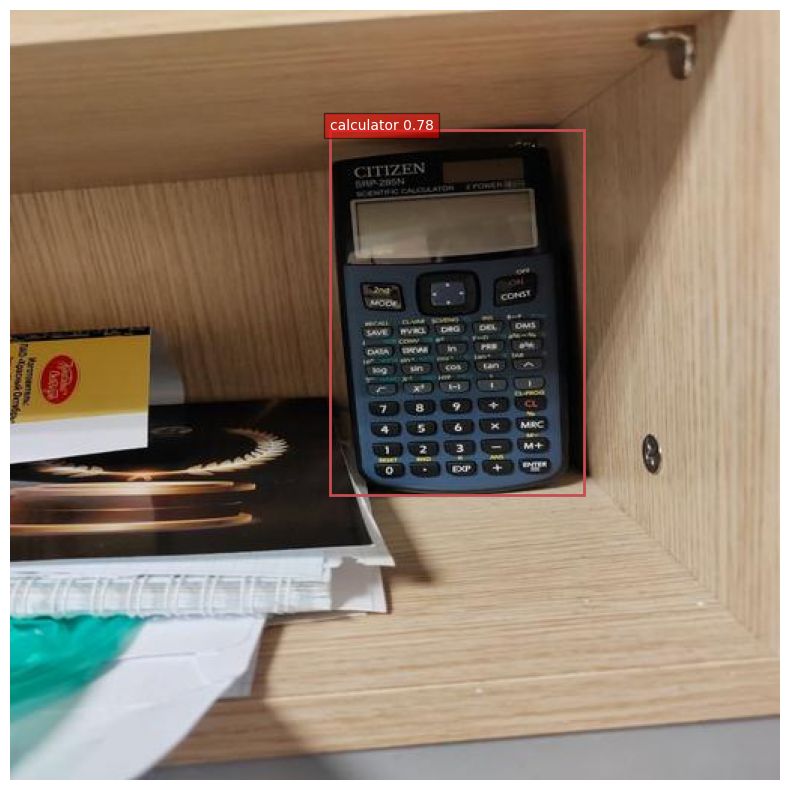


0: 512x512 1 chocolate, 13.2ms
Speed: 1.5ms preprocess, 13.2ms inference, 2.1ms postprocess per image at shape (1, 3, 512, 512)


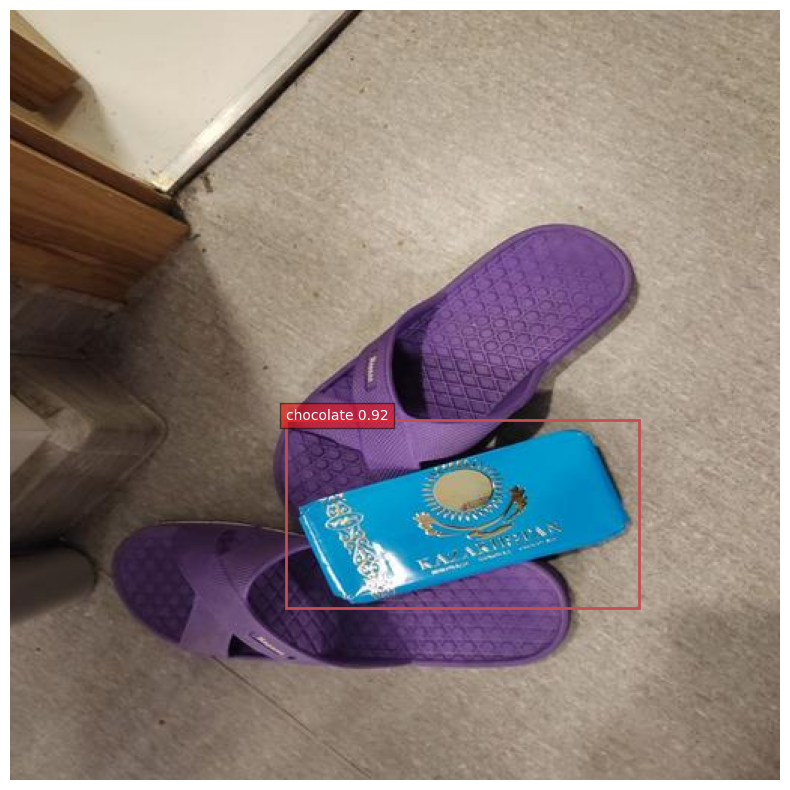


0: 512x512 1 calculator, 12.5ms
Speed: 1.4ms preprocess, 12.5ms inference, 2.4ms postprocess per image at shape (1, 3, 512, 512)


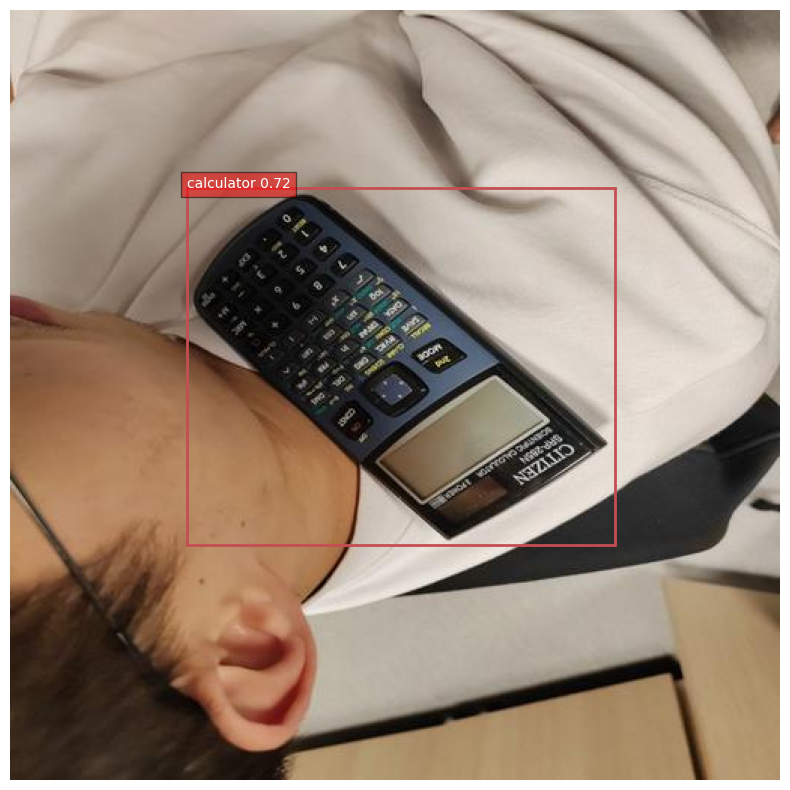


0: 512x512 1 calculator, 12.5ms
Speed: 1.6ms preprocess, 12.5ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


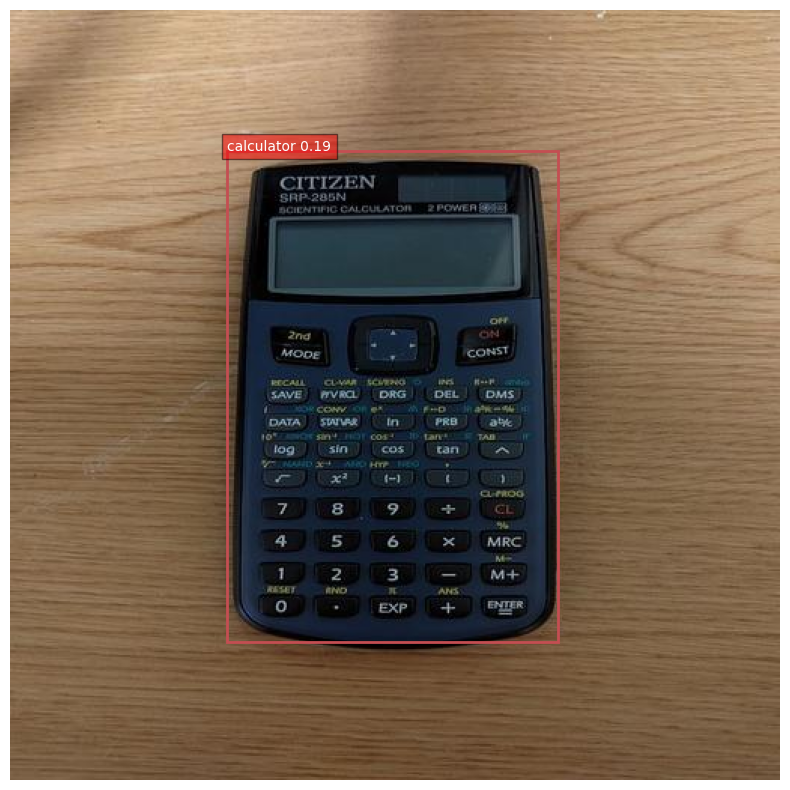


0: 512x512 1 calculator, 17.0ms
Speed: 1.4ms preprocess, 17.0ms inference, 4.2ms postprocess per image at shape (1, 3, 512, 512)


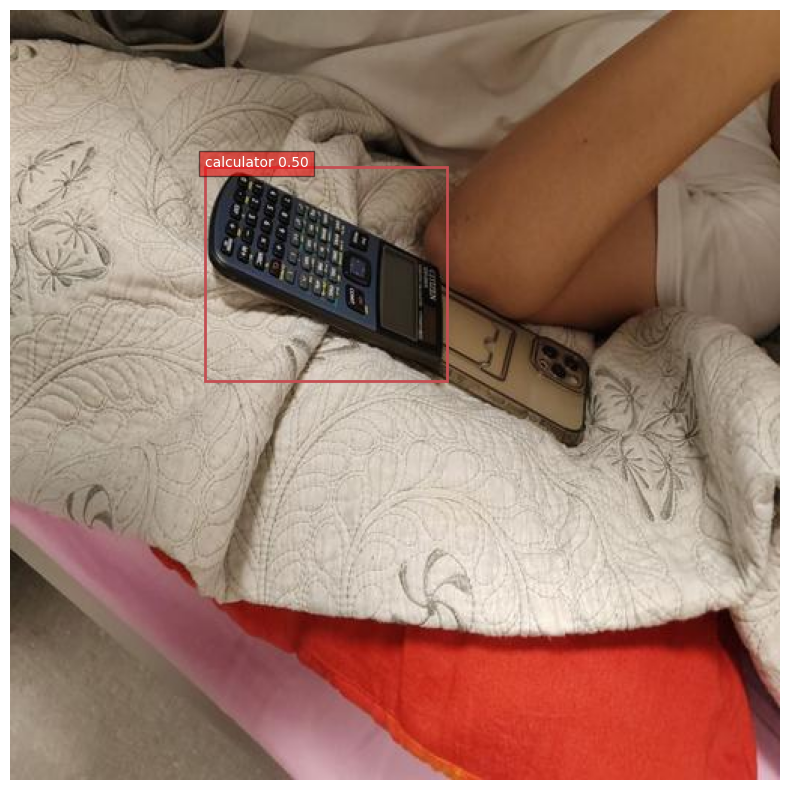


0: 512x512 1 chocolate, 12.4ms
Speed: 1.6ms preprocess, 12.4ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)


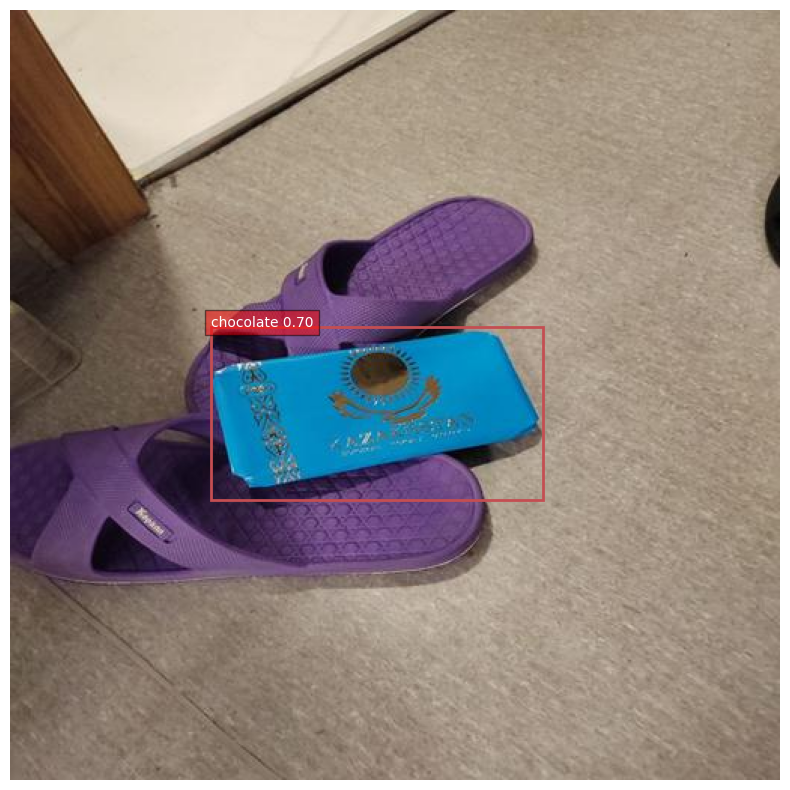


0: 512x512 1 calculator, 13.5ms
Speed: 1.5ms preprocess, 13.5ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)


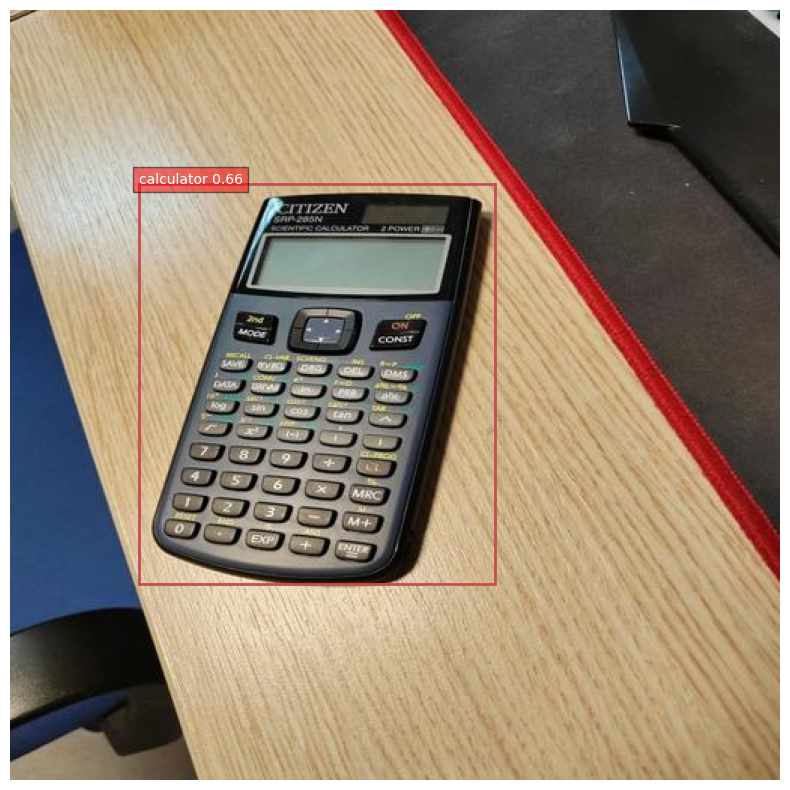


0: 512x512 1 calculator, 12.5ms
Speed: 1.4ms preprocess, 12.5ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


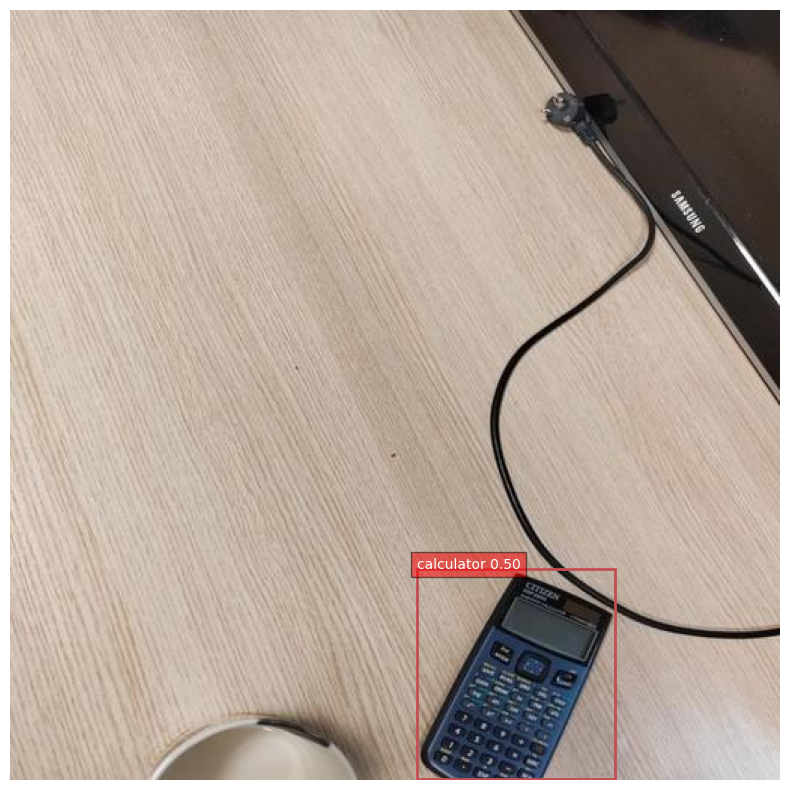


0: 512x512 1 chocolate, 12.0ms
Speed: 1.4ms preprocess, 12.0ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


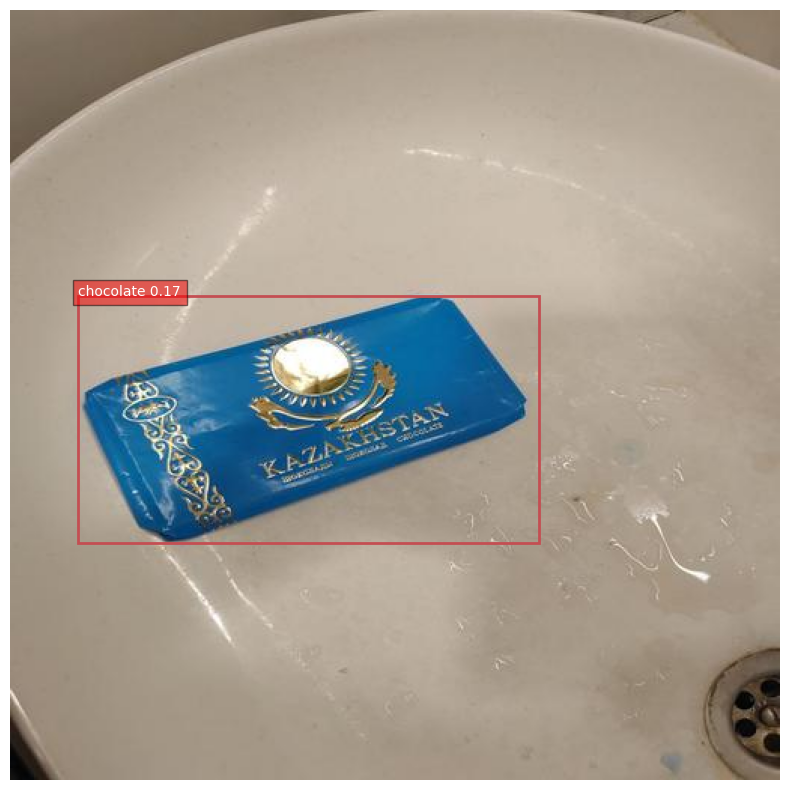


0: 512x512 1 chocolate, 17.9ms
Speed: 1.4ms preprocess, 17.9ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


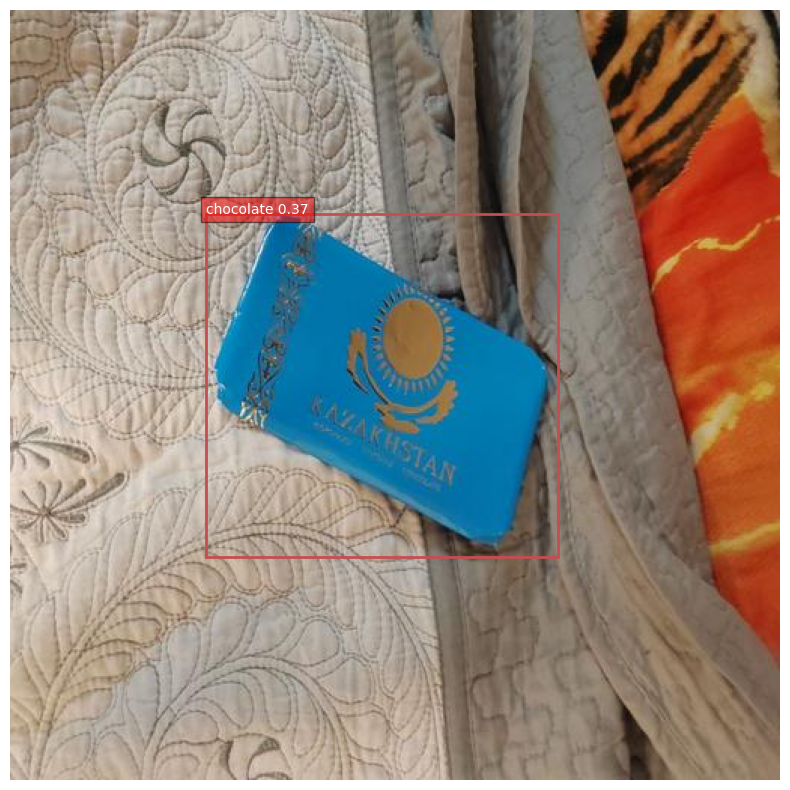


0: 512x512 1 calculator, 11.8ms
Speed: 1.4ms preprocess, 11.8ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)


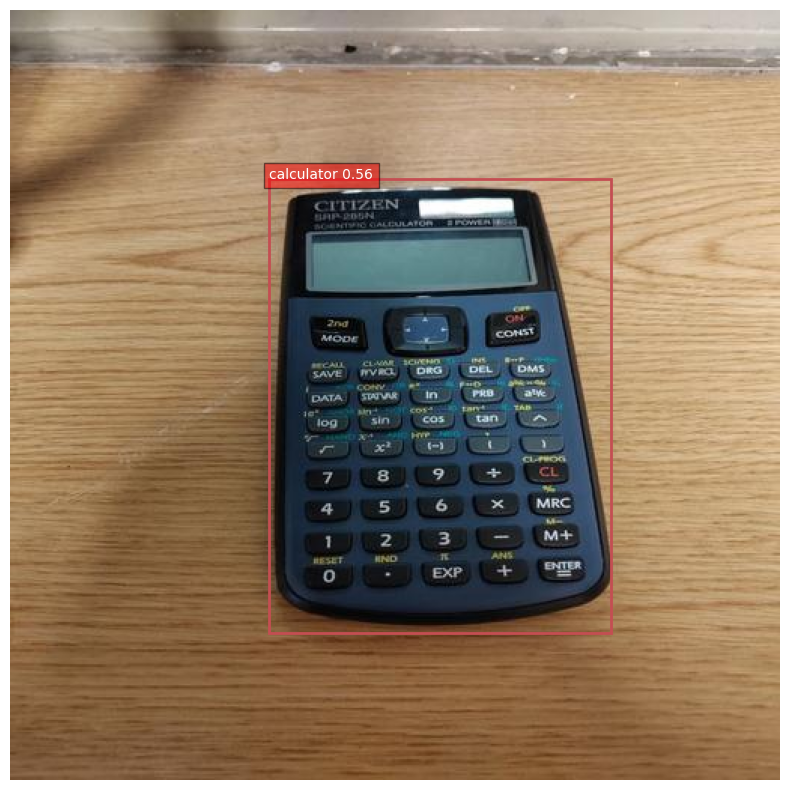

In [92]:
for i in range(len(os.listdir(f'{dataset_path}/labels/val'))):
    img_path = f"{dataset_path}/images/val/{os.listdir(f'{dataset_path}/images/val')[i]}"
    visualize_predictions(img_path)